Dataset name
============
SEN12MS

License
=======
CC-BY
The dataset contains Copernicus data (2017). Terms and conditions apply: https://scihub.copernicus.eu/twiki/pub/SciHubWebPortal/TermsConditions/TC_Sentinel_Data_31072014.pdf

Associated publication
======================
Schmitt M, Hughes LH, Qiu C, Zhu XX (2019) SEN12MS - A curated dataset of georeferenced multi-spectral Sentinel-1/2 imagery for deep learning and data fusion. ISPRS Annals of the Photogrammetry, Remote Sensing and Spatial Information Sciences IV-2/W7: 153-160

Links
=====
Dataset:	https://mediatum.ub.tum.de/1474000
Paper:		https://www.isprs-ann-photogramm-remote-sens-spatial-inf-sci.net/IV-2-W7/153/2019/


In [78]:
# Force build the entire cache after every version save or re run
import shutil,os
shutil.rmtree("/kaggle/working/cache", ignore_errors=True)   # wipe everything


# PREPROCESSING

In [1]:

!pip install torch torchvision torchaudio rasterio pillow matplotlib scikit-learn numpy


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.1 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 106.8 MB/s eta 0:00:0000:010:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 85.8 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 39.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.9 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 8.0 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 31.7 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 13.4 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 8.2 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 77.0 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 83.8 MB/s eta 0:00:00:00:0100:01
  Attempting un

In [1]:

"""
Complete SAR-to-EO Image Translation Preprocessing Pipeline
Designed for CycleGAN-based SAR-to-EO translation using Sen12MS dataset

Requirements:
- PyTorch
- torchvision  
- rasterio
- numpy
- PIL
- scikit-learn
- matplotlib

Usage:
    from sar_eo_preprocessing import SAR_EO_PreprocessingPipeline

    pipeline = SAR_EO_PreprocessingPipeline(
        sar_data_path="path/to/ROIs2017_winter_s1",
        eo_data_path="path/to/ROIs2017_winter_s2"
    )

    # Create DataLoaders for RGB configuration
    dataloaders = pipeline.setup_data_loaders(band_config='RGB')

    # Access individual DataLoaders
    train_loader = dataloaders['train']
    val_loader = dataloaders['val'] 
    test_loader = dataloaders['test']

    # Use in training loop
    for batch in train_loader:
        sar_images = batch['sar']  # Shape: (B, 2, H, W)
        eo_images = batch['eo']   # Shape: (B, 3, H, W) for RGB
        # ... training code ...
"""

import torch
import torch.nn as nn
import torch.utils.data as data
from torch.utils.data import DataLoader
import torchvision.transforms as transforms
import numpy as np
import os
import glob
from PIL import Image
import rasterio
from pathlib import Path
import matplotlib.pyplot as plt
from typing import Tuple, List, Dict, Optional, Union
import random
from sklearn.model_selection import train_test_split
from scipy.ndimage       import uniform_filter
from skimage.restoration import denoise_nl_means, estimate_sigma
import json
import warnings
warnings.filterwarnings('ignore')

import torch
from torch import nn
import cv2



# Band configurations for the three specified tasks
BAND_CONFIGS = {
    'RGB': [3, 2, 1],        # B4 (Red), B3 (Green), B2 (Blue)
    'NIR_SWIR_RE': [7, 10, 4], # B8 (NIR), B11 (SWIR), B5 (Red Edge)
    'RGB_NIR': [3, 2, 1, 7]    # B4, B3, B2, B8
}

def set_seed(seed=42):
    """Set random seeds for reproducibility"""
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(seed)
import numpy as np
from scipy.ndimage import uniform_filter

from scipy.ndimage import uniform_filter, convolve
import numpy as np


from scipy.ndimage import uniform_filter, correlate
import numpy as np
import cv2                                   # already used later

def refined_lee_filter(img: np.ndarray, win: int = 7, enl: float = 4.0):
    # 1 ─ window statistics -------------------------------------------------
    mean_w  = uniform_filter(img,  win, mode='reflect')
    mean2_w = uniform_filter(img**2, win, mode='reflect')
    var_w   = np.maximum(mean2_w - mean_w**2, 1e-8)

    # 2 ─ eight directional 3×win kernels ----------------------------------
    K = [
        np.array([[0,1,0],[0,1,0],[0,1,0]], np.float32),  # N–S
        np.array([[0,0,0],[1,1,1],[0,0,0]], np.float32),  # E–W
        np.array([[1,0,0],[0,1,0],[0,0,1]], np.float32),  # NW–SE
        np.array([[0,0,1],[0,1,0],[1,0,0]], np.float32)   # NE–SW
    ]
    K += [np.roll(k, s, axis=a) for k in K for a, s in [(0,1), (1,1)]]  # total 8

    means_dir, vars_dir = [], []
    for k in K:
        k /= k.sum()                               # normalise
        m  = correlate(img,   k, mode='reflect')   # ← changed line
        m2 = correlate(img**2, k, mode='reflect')  # ← changed line
        v  = np.maximum(m2 - m**2, 1e-8)
        means_dir.append(m); vars_dir.append(v)

    means_dir = np.stack(means_dir)                # (8,H,W)
    vars_dir  = np.stack(vars_dir)
    cv_dir    = np.sqrt(vars_dir) / means_dir

    idx   = np.argmin(cv_dir, axis=0)              # best direction per pixel
    mean  = means_dir[idx, np.arange(img.shape[0])[:, None], np.arange(img.shape[1])]
    cv_px =  cv_dir[idx, np.arange(img.shape[0])[:, None], np.arange(img.shape[1])]

    # 3 ─ Gamma-MAP weighting ----------------------------------------------
    cu = 1.0 / np.sqrt(enl)
    w  = np.clip((cv_px**2 - cu**2) / (cv_px**2 + 1.0), 0.0, 1.0)

    return (mean + w * (img - mean)).astype(np.float32)
    
def estimate_enl(tile: np.ndarray) -> float:
    """
    tile : (H,W,5) SAR cube AFTER Refined-Lee+NLM, still linear
           index 0 = VV band
    returns : scalar ENL in the range [0.5,12]
    """
    vv = tile[..., 0]
    mu  = vv.mean()
    var = vv.var() + 1e-8
    enl = (mu ** 2) / var                # definition
    return float(np.clip(enl, 0.5, 12.0))    # clamp outliers

    
class GAN_Normalization:
    """GAN-specific normalization to [-1, 1] range as required by CycleGAN"""
    def clip_linear(img: np.ndarray,
                low: float = 0.1,
                high: float = 99.9) -> np.ndarray:
        p_low, p_high = np.percentile(img, [low, high])
        return np.clip(img, p_low, p_high)
        
    @staticmethod
    def normalize_percentile(data: np.ndarray, lower_percentile: float = 0.1, 
                            upper_percentile: float = 99.9, min_val: float = -1.0, 
                            max_val: float = 1.0) -> np.ndarray:
        """Normalize using percentile clipping to handle outliers"""
        p_low, p_high = np.percentile(data, [lower_percentile, upper_percentile])
        data_clipped = np.clip(data, p_low, p_high)

        # Normalize to specified range
        data_min, data_max = np.min(data_clipped), np.max(data_clipped)
        if data_max == data_min:
            return np.full_like(data_clipped, (min_val + max_val) / 2)

        normalized = (data_clipped - data_min) / (data_max - data_min)
        return normalized * (max_val - min_val) + min_val

class SatelliteDataAugmentation:
    """Satellite-specific data augmentation preserving physical properties"""

    def __init__(self, image_size: Tuple[int, int] = (256, 256), augmentation_prob: float = 0.5):
        self.image_size = image_size
        self.aug_prob = augmentation_prob

    def apply_augmentations(self, sar_img: np.ndarray, eo_img: np.ndarray) -> Tuple[np.ndarray, np.ndarray]:
        # """Apply all augmentations consistently to SAR-EO pairs"""
        # # Spatial augmentations (applied consistently)
        # if np.random.random() < self.aug_prob:
        #     if np.random.random() < 0.5:  # Horizontal flip
        #         sar_img = np.fliplr(sar_img)
        #         eo_img = np.fliplr(eo_img)
        #     else:  # Vertical flip
        #         sar_img = np.flipud(sar_img)
        #         eo_img = np.flipud(eo_img)

        # # Random rotation
        # if np.random.random() < self.aug_prob:
        #     k = np.random.choice([1, 2, 3])
        #     sar_img = np.rot90(sar_img, k, axes=(0, 1))
        #     eo_img = np.rot90(eo_img, k, axes=(0, 1))

        # Intensity augmentations (applied independently)
        # if np.random.random() < self.aug_prob:
        #     # Add small amount of noise
        #     sar_noise = np.random.normal(0, 0.005, sar_img.shape)
        #     eo_noise = np.random.normal(0, 0.01, eo_img.shape)
        #     sar_img = np.clip(sar_img + sar_noise, -1, 1)
        #     eo_img = np.clip(eo_img + eo_noise, -1, 1)

        return sar_img, eo_img

class Sen12MSDataset(data.Dataset):
    """PyTorch Dataset for Sen12MS SAR-to-EO translation"""
    _SPLIT_CACHE = None
    def __init__(self, sar_dir: str, eo_dir: str, band_config: str = 'RGB',
                 image_size: Tuple[int, int] = (256, 256), apply_augmentation: bool = False,
                 augmentation_prob: float = 0.5, split: str = 'train',use_cache=True,
                 cache_dir="/kaggle/working/cache"):
        self.use_cache = use_cache
        self.cache_dir = Path(cache_dir)
        self.cache_dir.mkdir(exist_ok=True)

        self.sar_dir = Path(sar_dir)
        self.eo_dir = Path(eo_dir)
        self.band_config = band_config
        self.image_size = image_size
        self.apply_augmentation = apply_augmentation and (split == 'train')

        if band_config not in BAND_CONFIGS:
            raise ValueError(f"Unknown band configuration: {band_config}")
        self.band_indices = BAND_CONFIGS[band_config]
        self.num_eo_bands = len(self.band_indices)

        if self.apply_augmentation:
            self.augmenter = SatelliteDataAugmentation(image_size, augmentation_prob)

        self.normalizer = GAN_Normalization()
        
        if Sen12MSDataset._SPLIT_CACHE is None:
            
            all_pairs = self._find_file_pairs()                 # 634 pairs
            train_pairs, tmp_pairs = train_test_split(
                all_pairs, test_size=0.30, random_state=42, shuffle=True)
            val_pairs, test_pairs = train_test_split(
                tmp_pairs, test_size=0.50, random_state=42, shuffle=True)

            Sen12MSDataset._SPLIT_CACHE = {
                'train': train_pairs,
                'val'  : val_pairs,
                'test' : test_pairs
            }

        # ---------------------------------------------------------------------
        # 2. pick the subset that corresponds to the requested split
        # ---------------------------------------------------------------------
        self.file_pairs = Sen12MSDataset._SPLIT_CACHE[split]



        
        # self.file_pairs = self._find_file_pairs()

        self.cache_fmt = (self.cache_dir / f"{split}_{band_config}_{{:06d}}.pt")
        
        print(f"Sen12MSDataset - {band_config}: {len(self.file_pairs)} pairs, split: {split}")
    
    
    @staticmethod
    def _augment_sar_channels(sar: np.ndarray) -> np.ndarray:
        """
        Channel augmentation (linear scale)
        -----------------------------------
        Input
            sar : (H, W, 2)  →  [VV, VH] in linear power
    
        Output
            (H, W, 4) array with
              0  VV               (linear)
              1  VH               (linear)
              2  VV − VH          (difference, linear)
              3  |∇VV|            (Sobel gradient magnitude, linear)
        """
        vv, vh = sar[..., 0], sar[..., 1]
    
        # 1 ─ difference band -------------------------------------------------
        diff = vv - vh
    
        # 2 ─ Sobel gradient on VV -------------------------------------------
        gx = cv2.Sobel(vv, cv2.CV_32F, 1, 0, ksize=3)
        gy = cv2.Sobel(vv, cv2.CV_32F, 0, 1, ksize=3)
        grad = np.sqrt(gx**2 + gy**2)
    
        # 3 ─ stack to (H, W, 4) ---------------------------------------------
        return np.dstack([vv, vh, diff, grad]).astype(np.float32)
    @staticmethod 
    def clip_linear(img: np.ndarray,
                    low: float = 0.1,
                    high: float = 99.9
                   ) -> np.ndarray:
        p_low, p_high = np.percentile(img, [low, high])
        return np.clip(img, p_low, p_high)

    def _find_file_pairs(self) -> List[Tuple[Path, Path]]:
        """Find matching SAR and EO file pairs"""
        pairs = []
        sar_files = list(self.sar_dir.glob("*_s1_*.tif*"))

        for sar_file in sar_files:
            eo_filename = sar_file.name.replace('_s1_', '_s2_')
            eo_file = self.eo_dir / eo_filename

            if eo_file.exists():
                pairs.append((sar_file, eo_file))
            else:
                # Try alternative extensions
                for ext in ['.tif', '.tiff']:
                    eo_file_alt = self.eo_dir / (eo_filename.rsplit('.', 1)[0] + ext)
                    if eo_file_alt.exists():
                        pairs.append((sar_file, eo_file_alt))
                        break

        return pairs

    def _load_raster(self, file_path: Path) -> np.ndarray:
        """Load raster file and return as numpy array"""
        try:
            with rasterio.open(file_path) as src:
                data = src.read()  # (bands, height, width)
                data = np.transpose(data, (1, 2, 0))  # (height, width, bands)
                return data.astype(np.float32)
        except Exception as e:
            print(f"Error loading {file_path}: {e}")
            return None

    def _select_bands(self, eo_data: np.ndarray) -> np.ndarray:
        """Select specified bands from EO data"""
        if eo_data.shape[2] < max(self.band_indices) + 1:
            raise ValueError(f"EO data has {eo_data.shape[2]} bands, "
                           f"but configuration requires band {max(self.band_indices) + 1}")
        return eo_data[:, :, self.band_indices]

    def _resize_if_needed(self, data: np.ndarray) -> np.ndarray:
        """Resize data if needed"""
        current_size = data.shape[:2]
        if current_size != self.image_size:
            if len(data.shape) == 3:
                resized_bands = []
                for i in range(data.shape[2]):
                    band = data[:, :, i]
                    band_pil = Image.fromarray(band)
                    band_resized = band_pil.resize((self.image_size[1], self.image_size[0]), 
                                                  Image.LANCZOS)
                    resized_bands.append(np.array(band_resized))
                return np.stack(resized_bands, axis=2)
            else:
                data_pil = Image.fromarray(data)
                data_resized = data_pil.resize((self.image_size[1], self.image_size[0]), Image.LANCZOS)
                return np.array(data_resized)
        return data
    
    @staticmethod
    def despeckle_sar(arr, method="refined_lee", win=5):
        """
        arr   : (H,W,2) SAR tensor in linear scale
        method: 'lee' | 'refined_lee' | 'median' | 'gaussian'
        win   : window size for Lee / Median (ignored by refined_lee)
        """
        out = np.empty_like(arr, dtype=np.float32)
    
        for c in range(arr.shape[2]):
            ch = arr[..., c].astype(np.float32)
    
            if method == "refined_lee":          # ← new branch
                out[..., c] = refined_lee_filter(ch, win=7, enl=4.0)
    
            elif method == "median":
                out[..., c] = cv2.medianBlur(ch, win | 1)
    
            elif method == "gaussian":
                out[..., c] = cv2.GaussianBlur(ch, (win, win), 0)
    
            else:
                raise ValueError(f"Unknown despeckle method: {method}")

        return out



    def __len__(self) -> int:
        return len(self.file_pairs)

    def __getitem__(self, idx: int) -> Dict[str, torch.Tensor]:
        """Get a data sample"""
        # cache_file = self.cache_fmt.with_name(self.cache_fmt.name.format(idx))
        # if self.use_cache and cache_file.exists():
        #     return torch.load(cache_file)       # hit → 0.3 ms

        cache_file = self.cache_fmt.with_name(self.cache_fmt.name.format(idx))
        if self.use_cache and cache_file.exists():
            return torch.load(cache_file)     
            
        # inside Sen12MSDataset.__getitem__
        # --- new: speckle filtering -------------------------------
        # ----------------------------------------------------------
        
        sar_file, eo_file = self.file_pairs[idx]
        sar_data = self._load_raster(sar_file)
        eo_data = self._load_raster(eo_file)

        
        if sar_data is None or eo_data is None:
            # Return dummy data if loading failed
            sar_data = np.zeros((self.image_size[0], self.image_size[1], 2), dtype=np.float32)
            eo_data = np.zeros((self.image_size[0], self.image_size[1], self.num_eo_bands), dtype=np.float32)
        else:
            # Process data
            enl_scalar = torch.tensor(
            [estimate_enl(sar_data)],          # ← calls your helper
            dtype=torch.float32
    )
            eo_data = self._select_bands(eo_data)
            sar_data = self._resize_if_needed(sar_data)
            eo_data = self._resize_if_needed(eo_data)
            sar_data = self.despeckle_sar(sar_data, method="refined_lee", win=5)
            sar_data = self._augment_sar_channels(sar_data)
            enl_scalar = torch.tensor([estimate_enl(sar_data)],
                          dtype=torch.float32)
            sar_data = self.clip_linear(sar_data) 
            # Normalize to [-1, 1]
            sar_data = self.normalizer.normalize_percentile(sar_data)
            eo_data = self.normalizer.normalize_percentile(eo_data)

            # Apply augmentations
            if self.apply_augmentation:
                sar_data, eo_data = self.augmenter.apply_augmentations(sar_data, eo_data)

        # Convert to PyTorch tensors (C, H, W)
        # Check and fix contiguity before tensor conversion
            if not sar_data.flags['C_CONTIGUOUS']:
                sar_data = np.ascontiguousarray(sar_data)
            if not eo_data.flags['C_CONTIGUOUS']:
                eo_data = np.ascontiguousarray(eo_data)

            sar_tensor = torch.from_numpy(sar_data).permute(2, 0, 1).float()
            eo_tensor = torch.from_numpy(eo_data).permute(2, 0, 1).float()
            sample = {
                "sar"        : sar_tensor,   # FP16 → ½ disk + AMP-friendly
                "eo"         : eo_tensor,
                "enl"       : enl_scalar,   
                "sar_path"   : str(sar_file),
                "eo_path"    : str(eo_file),
                "band_config": self.band_config
            }
            if self.use_cache:
                torch.save(sample, cache_file)

        return sample;

class EvaluationMetrics:
    """Evaluation metrics for SAR-to-EO translation"""

    @staticmethod
    def calculate_psnr(img1: np.ndarray, img2: np.ndarray, max_val: float = 2.0) -> float:
        """Calculate PSNR"""
        mse = np.mean((img1 - img2) ** 2)
        if mse == 0:
            return float('inf')
        return 20 * np.log10(max_val / np.sqrt(mse))

    @staticmethod
    def calculate_ssim(img1: np.ndarray, img2: np.ndarray) -> float:
        """Calculate SSIM (simplified version)"""
        C1, C2 = (0.01 * 2) ** 2, (0.03 * 2) ** 2

        mu1, mu2 = np.mean(img1), np.mean(img2)
        mu1_sq, mu2_sq, mu1_mu2 = mu1**2, mu2**2, mu1*mu2

        sigma1_sq = np.mean(img1**2) - mu1_sq
        sigma2_sq = np.mean(img2**2) - mu2_sq
        sigma12 = np.mean(img1*img2) - mu1_mu2

        numerator = (2*mu1_mu2 + C1) * (2*sigma12 + C2)
        denominator = (mu1_sq + mu2_sq + C1) * (sigma1_sq + sigma2_sq + C2)

        return numerator / denominator

    @staticmethod
    def calculate_ndvi(red_band: np.ndarray, nir_band: np.ndarray) -> np.ndarray:
        """Calculate NDVI"""
        denominator = nir_band + red_band
        ndvi = np.divide(nir_band - red_band, denominator, 
                        out=np.zeros_like(denominator), where=denominator != 0)
        return ndvi

class SAR_EO_PreprocessingPipeline:
    """Complete SAR-to-EO preprocessing pipeline"""

    def __init__(self, sar_data_path: str, eo_data_path: str, config: Dict[str, any] = None):
        self.sar_data_path = sar_data_path
        self.eo_data_path = eo_data_path

        self.config = {
            'band_config': 'RGB',
            'image_size': (256, 256),
            'batch_size': 1,
            'num_workers': 4,
            'train_split': 0.7,
            'val_split': 0.15,
            'test_split': 0.15,
            'augmentation_prob': 0.5,
            'shuffle': True,
            'pin_memory': True
        }

        if config:
            self.config.update(config)

    def setup_data_loaders(self, band_config: str = None) -> Dict[str, DataLoader]:
        """Setup PyTorch DataLoaders for all splits"""
        if band_config:
            self.config['band_config'] = band_config

        datasets = {}
        for split_name in ['train', 'val', 'test']:
            datasets[split_name] = Sen12MSDataset(
                sar_dir=self.sar_data_path,
                eo_dir=self.eo_data_path,
                band_config=self.config['band_config'],
                image_size=self.config['image_size'],
                apply_augmentation=(split_name == 'train'),
                augmentation_prob=self.config['augmentation_prob'],
                split=split_name,
                use_cache = True,                       # ← new
                cache_dir = "/kaggle/working/cache"     # ← new (or any path)

            )

        dataloaders = {}
        for split_name, dataset in datasets.items():
            dataloaders[split_name] = DataLoader(
                dataset=dataset,
                batch_size=self.config['batch_size'],
                shuffle=self.config['shuffle'] and (split_name == 'train'),
                num_workers=self.config['num_workers'],
                pin_memory=self.config['pin_memory'] and torch.cuda.is_available(),
                drop_last=(split_name == 'train')
            )

        return dataloaders

    def create_all_configurations(self) -> Dict[str, Dict[str, DataLoader]]:
        """Create DataLoaders for all three band configurations"""
        all_configs = {}
        for config_name in BAND_CONFIGS.keys():
            print(f"Creating {config_name} DataLoaders...")
            all_configs[config_name] = self.setup_data_loaders(config_name)
        return all_configs
import numpy as np
from scipy.ndimage import uniform_filter

def lee_gamma_map(channel: np.ndarray,
                  window: int = 7,
                  enl: float = 4.0) -> np.ndarray:
    """
    channel : 2-D SAR power (float32, non-log).
    window  : odd kernel size (5, 7, 9 …).
    enl     : equivalent number of looks (typ. 4 for GRD, 1 for SLC).
    returns : filtered 2-D array in same domain.
    """
    # 1 – local statistics
    mean = uniform_filter(channel, window)
    mean_sq = uniform_filter(channel**2, window)
    var = np.maximum(mean_sq - mean**2, 1e-8)

    # 2 – coefficient of variation
    cu = 1.0 / np.sqrt(enl)                       # noise C.V.
    c  = np.sqrt(var) / mean                      # local C.V.

    # 3 – homogeneous / heterogeneous decision
    mask_hom  = c <= cu                           # homogeneous areas
    mask_het  = ~mask_hom                         # heterogeneous / textured

    # 4 – Lee Gamma-MAP estimator
    z = np.empty_like(channel)

    # (a) homogeneous: simple local mean
    z[mask_hom] = mean[mask_hom]

    # (b) heterogeneous: MAP estimator
    ci = (c[mask_het]**2 - cu**2) / (c[mask_het]**2 + 1)
    z[mask_het] = mean[mask_het] + ci * (channel[mask_het] - mean[mask_het])

    return z

# Example usage
if __name__ == "__main__":
    set_seed(42)

    # Initialize pipeline
    pipeline = SAR_EO_PreprocessingPipeline(
        sar_data_path="/kaggle/input/custom-sar-eo/New folder/SAR",  # Update with actual path
        eo_data_path="/kaggle/input/custom-sar-eo/New folder/EO",   # Update with actual path
        config={
            'batch_size': 4,
            'image_size': (256, 256),
            'augmentation_prob': 0.5
        }
    )

    # Create DataLoaders for RGB configuration
    dataloaders = pipeline.setup_data_loaders(band_config='RGB')

    # Access individual DataLoaders
    train_loader = dataloaders['train']
    val_loader = dataloaders['val']
    test_loader = dataloaders['test']

    print(f"DataLoaders created:")
    print(f"  Train: {len(train_loader)} batches")
    print(f"  Val: {len(val_loader)} batches")
    print(f"  Test: {len(test_loader)} batches")

    # Example training loop structure
    # print("\nExample usage in training loop:")
    # print("for epoch in range(num_epochs):")
    # print("    for batch in train_loader:")
    # print("        sar_images = batch['sar']  # Shape: (B, 2, H, W)")
    # print("        eo_images = batch['eo']   # Shape: (B, 3, H, W) for RGB")
    # print("        # ... CycleGAN training code ...")


Sen12MSDataset - RGB: 443 pairs, split: train
Sen12MSDataset - RGB: 95 pairs, split: val
Sen12MSDataset - RGB: 96 pairs, split: test
DataLoaders created:
  Train: 110 batches
  Val: 24 batches
  Test: 24 batches


In [2]:

"""
Example usage of the SAR-to-EO preprocessing pipeline
Run this after downloading the Sen12MS winter dataset
"""

# from sar_eo_preprocessing_pipeline import SAR_EO_PreprocessingPipeline, set_seed
import torch

def main():
    set_seed(42)

    # Update these paths with your actual data locations
    SAR_DATA_PATH = "/kaggle/input/custom-sar-eo/New folder/SAR"
    EO_DATA_PATH = "/kaggle/input/custom-sar-eo/New folder/EO"

    # Configuration for CycleGAN training
    config = {
        'batch_size': 1,        # CycleGAN typically uses batch_size=1
        'image_size': (256, 256),
        'num_workers': 1,
        'augmentation_prob': 0.5
    }

    # Initialize pipeline
    pipeline = SAR_EO_PreprocessingPipeline(SAR_DATA_PATH, EO_DATA_PATH, config)
    # -------------------------------------------------------------
# Utility: pre-build the cached *.pt files for every band-set
# -------------------------------------------------------------
    def build_cache(pipeline_obj, band_cfg):
        """
        Walk through the training Dataset once; every call to __getitem__
        writes a float16 tensor pair (<sar>, <eo>) to
        /kaggle/working/cache/<split>_<cfg>_<idx>.pt
        """
        ds = pipeline_obj.setup_data_loaders(band_cfg)['train'].dataset
        ds.use_cache = True        # make sure __getitem__ can write
        for i in range(len(ds)):
            _ = ds[i]              # triggers save
        print(f"{band_cfg} cache done → {ds.cache_dir}")
    
    # --------- run BEFORE starting any training ----------
    for cfg in ['RGB', 'RGB_NIR', 'NIR_SWIR_RE']:
        build_cache(pipeline, cfg)

    # Create DataLoaders for all three configurations
    print("Creating DataLoaders for all band configurations...")

    all_dataloaders = pipeline.create_all_configurations()

    # Example: Train CycleGAN for RGB configuration
    rgb_loaders = all_dataloaders['RGB']
    train_loader = rgb_loaders['train']

    print(f"\nRGB configuration ready:")
    print(f"  Training samples: {len(train_loader.dataset)}")

    # Example batch processing
    for i, batch in enumerate(train_loader):
        sar_images = batch['sar']  # Shape: (1, 2, 256, 256)
        eo_images = batch['eo']    # Shape: (1, 3, 256, 256)

        print(f"Batch {i+1}:")
        print(f"  SAR shape: {sar_images.shape}")
        print(f"  EO shape: {eo_images.shape}")
        print(f"  SAR range: [{sar_images.min():.3f}, {sar_images.max():.3f}]")
        print(f"  EO range: [{eo_images.min():.3f}, {eo_images.max():.3f}]")

        # Here you would feed the data to your CycleGAN model
        # fake_eo = generator_AtoB(sar_images)
        # fake_sar = generator_BtoA(eo_images)

        if i >= 2:  # Just show first few batches
            break

    print("\nPipeline ready for CycleGAN training!")

if __name__ == "__main__":
    main()


Sen12MSDataset - RGB: 443 pairs, split: train
Sen12MSDataset - RGB: 95 pairs, split: val
Sen12MSDataset - RGB: 96 pairs, split: test
RGB cache done → /kaggle/working/cache
Sen12MSDataset - RGB_NIR: 443 pairs, split: train
Sen12MSDataset - RGB_NIR: 95 pairs, split: val
Sen12MSDataset - RGB_NIR: 96 pairs, split: test
RGB_NIR cache done → /kaggle/working/cache
Sen12MSDataset - NIR_SWIR_RE: 443 pairs, split: train
Sen12MSDataset - NIR_SWIR_RE: 95 pairs, split: val
Sen12MSDataset - NIR_SWIR_RE: 96 pairs, split: test
NIR_SWIR_RE cache done → /kaggle/working/cache
Creating DataLoaders for all band configurations...
Creating RGB DataLoaders...
Sen12MSDataset - RGB: 443 pairs, split: train
Sen12MSDataset - RGB: 95 pairs, split: val
Sen12MSDataset - RGB: 96 pairs, split: test
Creating NIR_SWIR_RE DataLoaders...
Sen12MSDataset - NIR_SWIR_RE: 443 pairs, split: train
Sen12MSDataset - NIR_SWIR_RE: 95 pairs, split: val
Sen12MSDataset - NIR_SWIR_RE: 96 pairs, split: test
Creating RGB_NIR DataLoaders..

# TRAIN CYCLE GAN

In [6]:
# ============================================================================
#  CycleGAN components for SAR ↔ EO translation
#  – EfficientNet-B0 encoder / slim decoder  (~5 M params per generator)
#  – Tiny 3-layer PatchGAN discriminator     (~0.22 M params)
#  Works with any H×W multiple of 32 (256×256 by default)
# ============================================================================

import torch
import torch.nn as nn
import torch.nn.functional as Fn          # ← use Fn, not F
import torch.nn.utils as nn_utils
from typing import Tuple
import timm                               # pip install timm

# ───────────────────────── helper layers ──────────────────────────
def sn_conv(*args, **kw) -> nn.Conv2d:     # spectral-norm conv
    kw.setdefault("bias", False)
    return nn_utils.spectral_norm(nn.Conv2d(*args, **kw))


def upsample(x: torch.Tensor) -> torch.Tensor:
    # 2× bilinear upsample (now using Fn.interpolate)
    return Fn.interpolate(x, scale_factor=2, mode="bilinear",
                          align_corners=False)


class SafeTanh(nn.Module):                 # avoids hard ±1 clipping
    def forward(self, x):
        return torch.tanh(x).clamp(-0.999, 0.999)


# ───────────────────── EfficientNet-B0 generator ──────────────────
class EfficientGenerator(nn.Module):
    """
    EfficientNet-B0 encoder + light decoder
    Outputs full-resolution (256×256) tiles.
    """
    def __init__(self, in_c: int, out_c: int,
                 backbone: str = "efficientnet_b0"):
        super().__init__()

        # 1) Encoder (ImageNet-pre-trained)
        self.enc = timm.create_model(backbone,
                                     features_only=True,
                                     pretrained=True,
                                     in_chans=in_c)
        chs = self.enc.feature_info.channels()   # [16,24,40,112,1280]

        # 2) Up-blocks
        self.up4 = nn.Conv2d(chs[4] + chs[3], chs[3], 1)
        self.up3 = nn.Conv2d(chs[3] + chs[2], chs[2], 1)
        self.up2 = nn.Conv2d(chs[2] + chs[1], chs[1], 1)
        self.up1 = nn.Conv2d(chs[1] + chs[0], chs[0], 1)

        # 3) Head
        self.head = nn.Sequential(
            nn.Conv2d(chs[0], chs[0] // 2, 3, 1, 1, bias=False),
            nn.ReLU(True),
            nn.Conv2d(chs[0] // 2, out_c, 3, 1, 1, bias=False),
            SafeTanh()
        )

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        f0, f1, f2, f3, f4 = self.enc(x)         # ↓32,16,8,4,2

        d4 = upsample(f4); d4 = self.up4(torch.cat([d4, f3], 1))
        d3 = upsample(d4); d3 = self.up3(torch.cat([d3, f2], 1))
        d2 = upsample(d3); d2 = self.up2(torch.cat([d2, f1], 1))
        d1 = upsample(d2); d1 = self.up1(torch.cat([d1, f0], 1))

        d0 = upsample(d1)                        # 64 → 128 → 256
        return self.head(d0)                     # full-res output

# ────────────────────── tiny PatchGAN discriminator ──────────────
class TinyPatchGAN(nn.Module):
    """
    70×70 PatchGAN – 3 conv layers with spectral norm.
    """
    def __init__(self, in_c: int, base: int = 32):
        super().__init__()
        self.net = nn.Sequential(
            sn_conv(in_c,    base,   4, 2, 1), nn.LeakyReLU(0.2, True),
            sn_conv(base,   base*2,  4, 2, 1), nn.LeakyReLU(0.2, True),
            sn_conv(base*2,      1,  4, 1, 1)
        )

    def forward(self, x):
        return self.net(x)


# ───────────────────────── factory helper ─────────────────────────
import torch.nn as nn

class IgnoreENL(nn.Module):
    """
    Wrap any generator so that it still accepts (x, enl) but silently
    discards the second argument.  This lets you keep the original
    training loop untouched while switching to generators that do not
    use ENL at all (e.g. EfficientNet-based ones).
    """
    def __init__(self, core):
        super().__init__()
        self.core = core                 # EfficientGenerator, UNetLite, …

    def forward(self, x, enl=None):      # ← keeps the 2-arg call-signature
        return self.core(x)

# ============================================================================
# 2.  Build CycleGAN components (no-ENL version)
#    – wraps both generators with IgnoreENL
#    – keeps TinyPatchGAN discriminators unchanged
# ============================================================================
def build_cyclegan_components(cfg: str = "RGB"):
    """
    Returns 4 modules with call-signature:
        G_SAR2EO(x, enl)   ← enl ignored
        G_EO2SAR(x, enl)   ← enl ignored
        D_EO(x)
        D_SAR(x)
    cfg ∈ {"RGB", "RGB_NIR", "NIR_SWIR_RE"}
    """
    # ---- choose your backbone here --------------------------------------
    # Option A  (fastest, ≈5 M params) – EfficientNet-B0 encoder
    # Option B  (FILM-U-Net)           – original UNetRGenerator
    # from unetr_cyclegan import UNetLite, TinyPatchGAN

    eo_c = {"RGB":3, "RGB_NIR":4, "NIR_SWIR_RE":3}[cfg]

    G_S2E = IgnoreENL(EfficientGenerator(in_c=4,    out_c=eo_c))
    G_E2S = IgnoreENL(EfficientGenerator(in_c=eo_c, out_c=4))
    D_E   = TinyPatchGAN(in_c=eo_c)
    D_S   = TinyPatchGAN(in_c=4)
    return G_S2E, G_E2S, D_E, D_S


# ────────────────────────── sanity test ───────────────────────────
if __name__ == "__main__":
    G_S2E, G_E2S, D_E, D_S = build_cyclegan_components("RGB")   # RGB = 3 EO
    x  = torch.randn(1, 4, 256, 256)                            # fake SAR
    with torch.no_grad():
        y     = G_S2E(x)                                        # SAR → EO
        x_rec = G_E2S(y)                                        # EO  → SAR
    n_params = sum(p.numel() for p in G_S2E.parameters()) / 1e6
    print(f"Shapes : {x.shape} → {y.shape} → {x_rec.shape}")
    print(f"Generator params : {n_params:.2f} M")


Shapes : torch.Size([1, 4, 256, 256]) → torch.Size([1, 3, 256, 256]) → torch.Size([1, 4, 256, 256])
Generator params : 3.65 M


In [ ]:
# import glob

# def get_latest_ckpt(cfg, check_dir):
#     ckpt_files = sorted(glob.glob(f"{check_dir}/{cfg}_ep*.pth"))
#     if ckpt_files:
#         latest_ckpt = ckpt_files[-1]
#         return latest_ckpt
#     return None


In [ ]:
# batch = next(iter(train_loader))
# print(batch['sar'].shape)        # (B, 5, 256, 256)
# fake_X = F(batch['eo'].to(DEVICE))
# print(fake_X.shape)              # (B, 5, 256, 256)  ← should match


In [6]:
pip install pytorch_msssim

Note: you may need to restart the kernel to use updated packages.


In [7]:
# def clear_gpu():
#     import gc, torch, inspect
#     blacklist = {'torch', 'gc', 'inspect'}
#     for k,v in list(globals().items()):
#         if not k.startswith('_') and k not in blacklist and not inspect.ismodule(v):
#             del globals()[k]
#     gc.collect();  torch.cuda.empty_cache();  torch.cuda.ipc_collect()
# clear_gpu()

In [7]:
import os, time, itertools, torch
from pytorch_msssim import ms_ssim

# ─── one-time settings ──────────────────────────────────────────────
torch.backends.cudnn.benchmark = False          # ← 1️⃣ turn OFF
torch.backends.cudnn.deterministic = False
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

CHECK_DIR = "/kaggle/working/checkpoints"; os.makedirs(CHECK_DIR, exist_ok=True)

# ---------- hyper-parameters -----------------------------------------------
BATCH_SIZE       = 2
LR_G = LR_D       = 1e-4
LAMBDA_CYC        = 10
LAMBDA_SUP        = 10
MAX_EPOCH         = 15
GRAD_CLIP_NORM    = 1.0
MAX_LOSS_VALUE    = 1e4

# ---------- losses ----------------------------------------------------------
mse    = torch.nn.MSELoss()
l1     = torch.nn.L1Loss()
real_t = lambda p: mse(p, torch.full_like(p, 0.9))   # label smoothing
fake_t = lambda p: mse(p, torch.zeros_like(p))

def safe_ms_ssim(fake, real, eps=1e-3):
    noise  = eps * torch.randn_like(fake, dtype=torch.float32)
    fake32 = fake.float().clamp(-1, 1) + noise
    real32 = real.float().clamp(-1, 1)
    s = ms_ssim(fake32, real32, data_range=2.0, size_average=True)
    return (1.0 - torch.nan_to_num(s, nan=0.0)).clamp(0.0, 1.0)

def finite_or_skip(t, tag, opt_G=None, opt_D=None):
    if torch.isfinite(t).all():
        return True
    print(f"⚠ {tag} became non-finite – batch skipped")
    if opt_G: opt_G.zero_grad(set_to_none=True)
    if opt_D: opt_D.zero_grad(set_to_none=True)
    return False

# ---------- training loop ---------------------------------------------------
for cfg in ["RGB", "RGB_NIR", "NIR_SWIR_RE"]:
    print(f"\n═════ Training configuration: {cfg} ═════")

    # 1 ─ data
    loaders = pipeline.setup_data_loaders(cfg)
    train_loader = loaders["train"]

    # 2 ─ models
    G, F, D_Y, D_X = build_cyclegan_components(cfg)
    for m in (G, F, D_Y, D_X): m.to(DEVICE)
    if torch.cuda.device_count() > 1:
        G   = torch.nn.DataParallel(G)
        F   = torch.nn.DataParallel(F)
        D_Y = torch.nn.DataParallel(D_Y)
        D_X = torch.nn.DataParallel(D_X)


    # 3 ─ optimisers
    opt_G = torch.optim.Adam(itertools.chain(G.parameters(), F.parameters()),
                             lr=LR_G, betas=(0.5, 0.999))
    opt_D = torch.optim.Adam(itertools.chain(D_Y.parameters(), D_X.parameters()),
                             lr=LR_D, betas=(0.5, 0.999))

    # 4 ─ epoch loop
    for epoch in range(1, MAX_EPOCH + 1):
        t0 = time.time()
        for batch in train_loader:
            real_X = batch["sar"].to(DEVICE, non_blocking=True)
            real_Y = batch["eo" ].to(DEVICE, non_blocking=True)

            # ---- forward --------------------------------------------------
            fake_Y = G(real_X)              # SAR → EO
            fake_X = F(real_Y)              # EO  → SAR
            rec_X  = F(fake_Y)              # cycle
            rec_Y  = G(fake_X.detach())

            if not finite_or_skip(fake_Y, "fake_Y"): continue
            if not finite_or_skip(fake_X, "fake_X"): continue

            # ---- generator loss -------------------------------------------
            outY_f, outX_f = D_Y(fake_Y), D_X(fake_X)
            g_adv = (sum(real_t(o) for o in outY_f + outX_f) / 8)
            g_cyc = l1(rec_X, real_X) + l1(rec_Y, real_Y)
            g_sup = 0.5 * (l1(fake_Y, real_Y) + safe_ms_ssim(fake_Y, real_Y))
            g_tot = torch.clamp(g_adv + LAMBDA_CYC*g_cyc + LAMBDA_SUP*g_sup,
                                -MAX_LOSS_VALUE, MAX_LOSS_VALUE)

            if not finite_or_skip(g_tot, "g_tot", opt_G, opt_D): continue

            opt_G.zero_grad(set_to_none=True)
            g_tot.backward()
            torch.nn.utils.clip_grad_norm_(
                itertools.chain(G.parameters(), F.parameters()), GRAD_CLIP_NORM)
            opt_G.step()

            # ---- discriminator loss ---------------------------------------
            outY_r, outX_r = D_Y(real_Y), D_X(real_X)
            d_real = (sum(real_t(o)      for o in outY_r + outX_r) / 8)
            d_fake = (sum(fake_t(o.detach()) for o in outY_f + outX_f) / 8)
            d_tot  = torch.clamp(d_real + d_fake, -MAX_LOSS_VALUE, MAX_LOSS_VALUE)

            if not finite_or_skip(d_tot, "d_tot", opt_G, opt_D): continue

            opt_D.zero_grad(set_to_none=True)
            d_tot.backward()
            torch.nn.utils.clip_grad_norm_(
                itertools.chain(D_Y.parameters(), D_X.parameters()), GRAD_CLIP_NORM)
            opt_D.step()

        print(f"E{epoch:03d} | G {g_tot.item():6.3f} | D {d_tot.item():6.3f} "
              f"| {time.time()-t0:5.1f}s")

        # ---- checkpoint ---------------------------------------------------
        if epoch % 10 == 0 or epoch == MAX_EPOCH:
            torch.save(
                {"G":G.state_dict(), "F":F.state_dict(),
                 "D_Y":D_Y.state_dict(), "D_X":D_X.state_dict(),
                 "opt_G":opt_G.state_dict(), "opt_D":opt_D.state_dict(),
                 "epoch":epoch},
                f"{CHECK_DIR}/{cfg}_ep{epoch:03d}.pth")
            print("  ✔ checkpoint saved")


═════ Training configuration: RGB ═════
Sen12MSDataset - RGB: 443 pairs, split: train
Sen12MSDataset - RGB: 95 pairs, split: val
Sen12MSDataset - RGB: 96 pairs, split: test
E001 | G  9.500 | D  0.357 |  54.8s
E002 | G 10.283 | D  0.345 |  52.5s
E003 | G  7.649 | D  0.369 |  52.6s
E004 | G  9.280 | D  0.399 |  52.8s
E005 | G  7.574 | D  0.375 |  52.5s
E006 | G  9.067 | D  0.358 |  52.8s
E007 | G  7.527 | D  0.357 |  52.8s
E008 | G  7.240 | D  0.382 |  52.4s
E009 | G 10.495 | D  0.329 |  52.6s
E010 | G  8.650 | D  0.333 |  52.5s
  ✔ checkpoint saved
E011 | G  7.702 | D  0.356 |  52.3s
E012 | G  6.724 | D  0.356 |  52.7s
E013 | G  7.564 | D  0.388 |  52.4s
E014 | G  7.820 | D  0.380 |  52.4s
E015 | G  6.402 | D  0.421 |  52.7s
  ✔ checkpoint saved

═════ Training configuration: RGB_NIR ═════
Sen12MSDataset - RGB_NIR: 443 pairs, split: train
Sen12MSDataset - RGB_NIR: 95 pairs, split: val
Sen12MSDataset - RGB_NIR: 96 pairs, split: test
E001 | G  7.295 | D  0.424 |  53.1s
E002 | G  6.466 | 

In [30]:
import glob, re, os, pathlib

def get_latest_ckpt(cfg, ckpt_dir="/kaggle/working/checkpoints"):
    """
    Returns the path to the highest-epoch checkpoint for a band-set.
    Expects filenames like   f"{cfg}_ep###.pth".
    """
    patt = f"{cfg}_ep*.pth"
    paths = glob.glob(os.path.join(ckpt_dir, patt))
    if not paths:
        return None
    # extract the numeric epoch (last 3 digits before .pth), pick the max
    paths.sort(key=lambda p: int(re.search(r"_ep(\d{3})\.pth", p).group(1)))
    return paths[-1]


In [38]:
import os, re, glob, time, itertools, torch
from pytorch_msssim import ms_ssim

# ── paths & device ────────────────────────────────────────────────
CKPT_DIR = "/kaggle/working/checkpoints"
os.makedirs(CKPT_DIR, exist_ok=True)

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
torch.backends.cudnn.benchmark, torch.backends.cudnn.deterministic = False, False

# ── hyper-parameters ──────────────────────────────────────────────
BATCH_SIZE   = 2
LR_G = LR_D  = 1e-4
LAMBDA_CYC   = 10
LAMBDA_SUP   = 10
MAX_EPOCH    = 25
GRAD_CLIP    = 1.0
MAX_LOSS     = 1e4

# ── loss helpers ─────────────────────────────────────────────────
mse, l1 = torch.nn.MSELoss(), torch.nn.L1Loss()
real_t  = lambda p: mse(p, torch.full_like(p, 0.9))
fake_t  = lambda p: mse(p, torch.zeros_like(p))

def safe_ms_ssim(fake, real, eps=1e-3):
    noise  = eps * torch.randn_like(fake, dtype=torch.float32)
    fake32 = fake.float().clamp(-1, 1) + noise
    real32 = real.float().clamp(-1, 1)
    s      = ms_ssim(fake32, real32, data_range=2.0, size_average=True)
    return (1.0 - torch.nan_to_num(s, nan=0.0)).clamp(0.0, 1.0)

def finite_or_skip(t, tag, *opts):
    if torch.isfinite(t).all():
        return True
    print(f"⚠ {tag} became non-finite – batch skipped")
    for o in opts: o.zero_grad(set_to_none=True)
    return False

def latest_ckpt(cfg, d=CKPT_DIR):
    files = glob.glob(os.path.join(d, f"{cfg}_ep*.pth"))
    if not files:
        return None
    files.sort(key=lambda p: int(re.search(r"_ep(\d{3})\.pth", p).group(1)))
    return files[-1]

# ── training per band-set ────────────────────────────────────────
for cfg in ["RGB_NIR", "NIR_SWIR_RE"]:
    print(f"\n═════ {cfg} ═════")

    # 1 data
    loaders      = pipeline.setup_data_loaders(cfg)   # assumes your pipeline
    train_loader = loaders["train"]

    # 2 models on one GPU/CPU
    G, F, D_Y, D_X = build_cyclegan_components(cfg)
    for net in (G, F, D_Y, D_X):
        net.to(DEVICE)

    # 3 wrap with DataParallel *before* loading
    if torch.cuda.device_count() > 1:
        G, F, D_Y, D_X = map(torch.nn.DataParallel, (G, F, D_Y, D_X))

    # 4 optimisers
    opt_G = torch.optim.Adam(itertools.chain(G.parameters(), F.parameters()),
                             lr=LR_G, betas=(0.5, 0.999))
    opt_D = torch.optim.Adam(itertools.chain(D_Y.parameters(), D_X.parameters()),
                             lr=LR_D, betas=(0.5, 0.999))

    # 5 resume if checkpoint exists
    start_epoch, ckpt_path = 1, latest_ckpt(cfg)
    if ckpt_path:
        ckpt = torch.load(ckpt_path, map_location=DEVICE)
        G.load_state_dict(ckpt["G"]); F.load_state_dict(ckpt["F"])
        D_Y.load_state_dict(ckpt["D_Y"]); D_X.load_state_dict(ckpt["D_X"])
        opt_G.load_state_dict(ckpt["opt_G"]); opt_D.load_state_dict(ckpt["opt_D"])
        start_epoch = ckpt["epoch"] + 1
        print(f"▶ Resumed from {os.path.basename(ckpt_path)} (epoch {ckpt['epoch']})")
    else:
        print("▶ No checkpoint found – starting fresh")

    # 6 epoch loop
    for epoch in range(start_epoch, MAX_EPOCH + 1):
        t0, g_sum, d_sum, n = time.time(), 0.0, 0.0, 0

        for batch in train_loader:
            real_X = batch["sar"].to(DEVICE, non_blocking=True)
            real_Y = batch["eo"].to(DEVICE,  non_blocking=True)

            # ── generator step ─────────────────────────────────────────
            fake_Y = G(real_X)
            fake_X = F(real_Y)
            rec_X  = F(fake_Y)
            rec_Y  = G(fake_X.detach())

            outY_f, outX_f = D_Y(fake_Y), D_X(fake_X)
            g_adv = (sum(real_t(o) for o in outY_f + outX_f) / 8)
            g_cyc = l1(rec_X, real_X) + l1(rec_Y, real_Y)
            g_sup = 0.5 * (l1(fake_Y, real_Y) + safe_ms_ssim(fake_Y, real_Y))
            g_tot = torch.clamp(g_adv + LAMBDA_CYC * g_cyc + LAMBDA_SUP * g_sup,
                                -MAX_LOSS, MAX_LOSS)

            if not finite_or_skip(g_tot, "g_tot", opt_G, opt_D): continue

            opt_G.zero_grad(set_to_none=True)
            g_tot.backward()
            torch.nn.utils.clip_grad_norm_(itertools.chain(G.parameters(),
                                                           F.parameters()),
                                           GRAD_CLIP)
            opt_G.step()

            # ── discriminator step ─────────────────────────────────────
            outY_r, outX_r = D_Y(real_Y), D_X(real_X)
            d_real = (sum(real_t(o) for o in outY_r + outX_r) / 8)
            d_fake = (sum(fake_t(o.detach()) for o in outY_f + outX_f) / 8)
            d_tot  = torch.clamp(d_real + d_fake, -MAX_LOSS, MAX_LOSS)

            if not finite_or_skip(d_tot, "d_tot", opt_G, opt_D): continue

            opt_D.zero_grad(set_to_none=True)
            d_tot.backward()
            torch.nn.utils.clip_grad_norm_(itertools.chain(D_Y.parameters(),
                                                           D_X.parameters()),
                                           GRAD_CLIP)
            opt_D.step()

            # ── stats ─────────────────────────────────────────────────
            g_sum += g_tot.item(); d_sum += d_tot.item(); n += 1

        print(f"E{epoch:03d} | G {g_sum/n:6.3f} | D {d_sum/n:6.3f} | "
              f"{time.time() - t0:5.1f}s")

        # ── checkpoint ─────────────────────────────────────────────
        if epoch % 10 == 0 or epoch == MAX_EPOCH:
            torch.save(
                {"G": G.state_dict(),  "F": F.state_dict(),
                 "D_Y": D_Y.state_dict(), "D_X": D_X.state_dict(),
                 "opt_G": opt_G.state_dict(), "opt_D": opt_D.state_dict(),
                 "epoch": epoch},
                f"{CKPT_DIR}/{cfg}_ep{epoch:03d}.pth")
            print("  ✔ checkpoint saved")



═════ RGB_NIR ═════
Sen12MSDataset - RGB_NIR: 443 pairs, split: train
Sen12MSDataset - RGB_NIR: 95 pairs, split: val
Sen12MSDataset - RGB_NIR: 96 pairs, split: test
▶ Resumed from RGB_NIR_ep015.pth (epoch 15)
E016 | G  4.759 | D  0.392 |  55.0s
E017 | G  4.664 | D  0.395 |  55.0s
E018 | G  4.636 | D  0.395 |  54.8s
E019 | G  4.600 | D  0.398 |  54.9s
E020 | G  4.574 | D  0.397 |  55.2s
  ✔ checkpoint saved
E021 | G  4.515 | D  0.398 |  54.8s
E022 | G  4.461 | D  0.399 |  54.6s
E023 | G  4.468 | D  0.400 |  54.8s
E024 | G  4.349 | D  0.399 |  54.9s
E025 | G  4.336 | D  0.400 |  54.9s
  ✔ checkpoint saved

═════ NIR_SWIR_RE ═════
Sen12MSDataset - NIR_SWIR_RE: 443 pairs, split: train
Sen12MSDataset - NIR_SWIR_RE: 95 pairs, split: val
Sen12MSDataset - NIR_SWIR_RE: 96 pairs, split: test
▶ Resumed from NIR_SWIR_RE_ep015.pth (epoch 15)
E016 | G  3.591 | D  0.405 |  54.4s
E017 | G  3.517 | D  0.406 |  55.0s
E018 | G  3.533 | D  0.406 |  55.2s
E019 | G  3.502 | D  0.406 |  54.3s
E020 | G  3.45

In [41]:
!ls /kaggle/working/checkpoints

NIR_SWIR_RE_ep010.pth  RGB_ep010.pth	  RGB_NIR_ep015.pth
NIR_SWIR_RE_ep015.pth  RGB_ep015.pth	  RGB_NIR_ep020.pth
NIR_SWIR_RE_ep020.pth  RGB_ep020.pth	  RGB_NIR_ep025.pth
NIR_SWIR_RE_ep025.pth  RGB_NIR_ep010.pth


In [ ]:
# rm  /kaggle/working/checkpoints/NIR_SWIR_RE_ep025.pth


In [ ]:
# !find /kaggle/working/checkpoints -type f ! -name '*25*' -delete


# METRICS


In [42]:
# ----------------------------------------------------------------------
# 0.  imports & prerequisites  (all were installed earlier)
# ----------------------------------------------------------------------
import torch, numpy as np
from torchmetrics.image import StructuralSimilarityIndexMeasure, PeakSignalNoiseRatio
from pathlib import Path

# ----------------------------------------------------------------------
# 1.  helper wrappers  (reuse if you already copied them earlier)
# ----------------------------------------------------------------------
def denorm(x):                     #  [-1,1] ➜ [0,1]
    return (x.clamp(-1, 1) + 1) / 2

def make_metric_objects(n_ch):
    psnr = [PeakSignalNoiseRatio(data_range=2.) for _ in range(n_ch)]
    ssim = [StructuralSimilarityIndexMeasure(data_range=2.) for _ in range(n_ch)]
    return psnr, ssim

def update_metrics(psnr, ssim, fake, real):
    B, C, _, _ = fake.shape
    for c in range(C):
        psnr[c](fake[:, c:c+1], real[:, c:c+1])
        ssim[c](fake[:, c:c+1], real[:, c:c+1])

def ndvi_tensor(eo, red_idx, nir_idx):
    eo = denorm(eo)                           # linear reflectance
    nir, red = eo[:, nir_idx], eo[:, red_idx]
    return (nir - red) / (nir + red + 1e-6)

def ndvi_mae(fake, real, red_idx, nir_idx):
    return torch.mean(
        torch.abs(ndvi_tensor(fake, red_idx, nir_idx) -
                  ndvi_tensor(real, red_idx, nir_idx))
    ).item()

# ----------------------------------------------------------------------
# 2.  config → metadata
# ----------------------------------------------------------------------
CFG_META = {
    "RGB_NIR":      {"n_ch": 4, "has_ndvi": True,  "red": 0, "nir": 3,
                     "ckpt": "/kaggle/working/checkpoints/RGB_NIR_ep020.pth"},
    "NIR_SWIR_RE":  {"n_ch": 3, "has_ndvi": False, "ckpt":
                     "/kaggle/working/checkpoints/NIR_SWIR_RE_ep020.pth"},
    "RGB":  {"n_ch": 3, "has_ndvi": False, "ckpt":
                     "/kaggle/working/checkpoints/RGB_ep020.pth"},
}

# ----------------------------------------------------------------------
# 3.  metric runner
# ----------------------------------------------------------------------
def evaluate_model(cfg_name):
    meta = CFG_META[cfg_name]
    n_ch  = meta["n_ch"]

    # ---- (a) load generator -------------------------------------------------
    G, _, _, _ = build_cyclegan_components(cfg_name)
    state = torch.load(meta["ckpt"], map_location="cuda" if torch.cuda.is_available() else "cpu")
    G = torch.nn.DataParallel(G)
    G.load_state_dict(state["G"])
    DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    G = G.to(DEVICE).eval()

    # ---- (b) get validation loader -----------------------------------------
    loader_val = pipeline.setup_data_loaders(cfg_name)["test"]

    # ---- (c) metric containers ---------------------------------------------
    psnr_b, ssim_b = make_metric_objects(n_ch)
    psnr_b = [m.to(DEVICE) for m in psnr_b]
    ssim_b = [m.to(DEVICE) for m in ssim_b]
    ndvi_errors = []

    # ---- (d) loop -----------------------------------------------------------
    with torch.no_grad():
        for batch in loader_val:
            sar   = batch["sar"].to(DEVICE).float()       # FP-32 avoids dtype clashes
            real  = batch["eo" ].to(DEVICE).float()

            with torch.cuda.amp.autocast(enabled=(DEVICE.type == "cuda")):
                fake = G(sar)

            update_metrics(psnr_b, ssim_b, fake, real)

            if meta["has_ndvi"]:
                ndvi_errors.append(
                    ndvi_mae(fake, real, meta["red"], meta["nir"])
                )

    # ---- (e) aggregate & print ---------------------------------------------
    psnr_vals = [m.compute().item() for m in psnr_b]
    ssim_vals = [m.compute().item() for m in ssim_b]

    print(f"\n=== {cfg_name} validation metrics ===")
    print("Per-band PSNR :", [f"{v:0.2f} dB" for v in psnr_vals])
    print("Per-band SSIM :", [f"{v:0.3f}"    for v in ssim_vals])

    if meta["has_ndvi"]:
        print(f"NDVI MAE      : {float(np.mean(ndvi_errors)):.3f}")
    else:
        print("NDVI MAE      : n/a (band-set lacks both Red and NIR)")

# ----------------------------------------------------------------------
# 4.  run evaluations
# ----------------------------------------------------------------------
evaluate_model("RGB_NIR")
evaluate_model("NIR_SWIR_RE")
evaluate_model("RGB")

Sen12MSDataset - RGB_NIR: 443 pairs, split: train
Sen12MSDataset - RGB_NIR: 95 pairs, split: val
Sen12MSDataset - RGB_NIR: 96 pairs, split: test

=== RGB_NIR validation metrics ===
Per-band PSNR : ['15.92 dB', '20.37 dB', '21.89 dB', '12.14 dB']
Per-band SSIM : ['0.378', '0.672', '0.750', '0.064']
NDVI MAE      : 0.153
Sen12MSDataset - NIR_SWIR_RE: 443 pairs, split: train
Sen12MSDataset - NIR_SWIR_RE: 95 pairs, split: val
Sen12MSDataset - NIR_SWIR_RE: 96 pairs, split: test

=== NIR_SWIR_RE validation metrics ===
Per-band PSNR : ['17.09 dB', '43.81 dB', '20.98 dB']
Per-band SSIM : ['0.297', '0.954', '0.332']
NDVI MAE      : n/a (band-set lacks both Red and NIR)
Sen12MSDataset - RGB: 443 pairs, split: train
Sen12MSDataset - RGB: 95 pairs, split: val
Sen12MSDataset - RGB: 96 pairs, split: test

=== RGB validation metrics ===
Per-band PSNR : ['11.55 dB', '17.05 dB', '15.48 dB']
Per-band SSIM : ['0.019', '0.307', '0.096']
NDVI MAE      : n/a (band-set lacks both Red and NIR)


# VISUALIZATION

Sen12MSDataset - RGB: 443 pairs, split: train
Sen12MSDataset - RGB: 95 pairs, split: val
Sen12MSDataset - RGB: 96 pairs, split: test


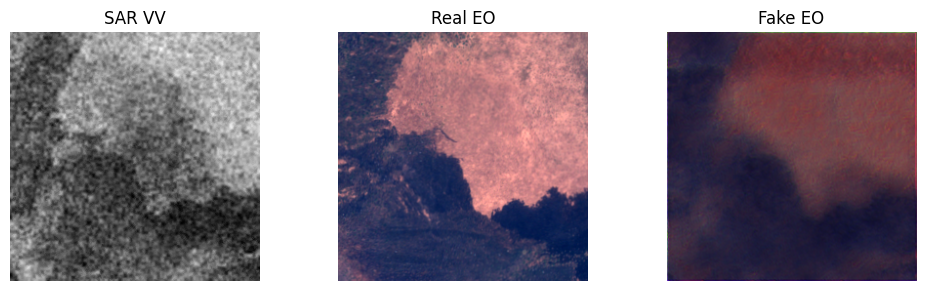

In [45]:
from matplotlib import pyplot as plt
loader_val = pipeline.setup_data_loaders("RGB")["val"]

# 1. pull one sample from your (CPU) DataLoader
batch = next(iter(loader_val))
sar_patch = batch['sar'][0].to(DEVICE).float()   # ← FP32 & CUDA
eo_real   = batch['eo'][0].to(DEVICE).float()

# 2. forward pass (FP32 or mixed precision)
with torch.no_grad(), torch.cuda.amp.autocast(enabled=False):
    fake = G(sar_patch.unsqueeze(0)).cpu()[0]    # back to CPU for plotting

# 3. helper to turn [-1,1] tensor → displayable RGB
def to_rgb(t):
    img = ((t[[0,1,2]].clamp(-1,1) + 1) / 2).permute(1,2,0).numpy()
    return img                     # gamma correction

# 4. show SAR VV, real EO, fake EO
plt.figure(figsize=(10,3))
plt.subplot(1,3,1); plt.title("SAR VV");  plt.imshow(((sar_patch[0]+1)/2).cpu(), cmap='gray'); plt.axis('off')
plt.subplot(1,3,2); plt.title("Real EO"); plt.imshow(to_rgb(eo_real.cpu()));                  plt.axis('off')
plt.subplot(1,3,3); plt.title("Fake EO"); plt.imshow(to_rgb(fake));                           plt.axis('off')
plt.tight_layout();  plt.show()


In [ ]:
# sample = torch.load('cache/train_RGB_NIR_000010.pt')
# print(sample['eo'].shape)        # should be (4,256,256)\n```


In [46]:
def stretch_linear(arr, p_low=2, p_high=98, gamma=1/2.2):
    if hasattr(arr, "cpu"):          # accept torch or NumPy
        arr = arr.cpu().numpy()
    lo, hi = np.percentile(arr, (p_low, p_high))
    arr = np.clip(arr, lo, hi)
    return ((arr - lo) / (hi - lo + 1e-8)) ** gamma


In [61]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import os
from pathlib import Path

class SARtoEOSampleGenerator:
    """Complete class for generating SAR → EO sample results with before/after visualizations"""
    
    def __init__(self, generator, device, pipeline, cfg="RGB_NIR"):
        self.G = generator
        self.device = device
        self.pipeline = pipeline
        self.cfg = cfg
        self.results_dir = Path("/kaggle/working/sar_eo_samples")
        self.results_dir.mkdir(exist_ok=True)
        
    def to_lin(self, x):
        """Convert [-1,1] → [0,1] with float32 dtype for matplotlib"""
        return ((x.clamp(-1, 1) + 1) / 2).cpu().numpy().astype(np.float32)
    
    def gamma_correct(self, img):
        """Apply gamma correction for display"""
        return np.clip(img ** (1/2.2), 0, 1).astype(np.float32)
    
    def create_rgb_composite(self, eo_tensor):
        """Create RGB composite from EO tensor based on band configuration"""
        if self.cfg == "NIR_SWIR_RE":
            # False color composite: NIR(R), RedEdge(G), SWIR(B)
            rgb = self.gamma_correct(self.to_lin(eo_tensor[[0, 2, 1]].permute(1, 2, 0)))
        else:
            # True color RGB for RGB and RGB_NIR configurations  
            rgb = self.gamma_correct(self.to_lin(eo_tensor[[0, 1, 2]].permute(1, 2, 0)))
        return rgb
    
    def create_ndvi_map(self, eo_tensor, red_idx=0, nir_idx=3):
        """Create NDVI visualization if both red and NIR bands are available"""
        if nir_idx >= eo_tensor.shape[0]:
            return None
        
        red = self.to_lin(eo_tensor[red_idx])
        nir = self.to_lin(eo_tensor[nir_idx])
        ndvi = (nir - red) / (nir + red + 1e-6)
        return ndvi
    @staticmethod
    def create_false_color_sar(vv_tensor, vh_tensor, eps=1e-6):
        """
        Build an RGB composite directly from *linear* VV & VH.
    
        R = VV (linear)
        G = VH (linear)
        B = VV / VH ratio (linear)
    
        Parameters
        ----------
        vv_tensor, vh_tensor : torch.Tensor (H, W), linear power
    
        Returns
        -------
        rgb : NumPy array (H, W, 3), float32 in [0,1]
        """
        vv_lin = vv_tensor.float()
        vh_lin = vh_tensor.float()
    
        # ratio keeps units dimensionless and emphasises contrast
        ratio  = vv_lin / (vh_lin + eps)
    
        r = stretch_linear(vv_lin)
        g = stretch_linear(vh_lin)
        b = stretch_linear(ratio)
    
        rgb = np.dstack([r, g, b]).astype(np.float32)
        return rgb
 # optional gamma


    def generate_single_sample(self, sample_idx, save_individual=True):
        """Generate one SAR → EO sample result with detailed analysis"""
        
        # Get validation data
        loader_val = self.pipeline.setup_data_loaders(self.cfg)["val"]
        dataset = loader_val.dataset
        
        if sample_idx >= len(dataset):
            print(f"Sample {sample_idx} exceeds dataset size {len(dataset)}")
            return None
            
        sample = dataset[sample_idx]
        sar_patch = sample["sar"].to(self.device).float()
        eo_real = sample["eo"].cpu()
        
        # Generate fake EO
        with torch.no_grad(), torch.cuda.amp.autocast(enabled=(self.device.type == 'cuda')):
            fake_eo = self.G(sar_patch.unsqueeze(0))[0].cpu()
        
        # Create visualizations
        false_rgb = self.create_false_color_sar(sar_patch[0], sar_patch[1])
        real_rgb = self.create_rgb_composite(eo_real)
        fake_rgb = self.create_rgb_composite(fake_eo)

        
        result = {
            'sample_idx': sample_idx,
            'false_rgb': false_rgb,
            'eo_real': eo_real,
            'eo_fake': fake_eo,
            'real_rgb': real_rgb,
            'fake_rgb': fake_rgb,
            'sar_path': sample.get('sar_path', ''),
            'eo_path': sample.get('eo_path', '')
        }
        
        # Add NDVI if available (RGB_NIR configuration)
        if self.cfg == "RGB_NIR":
            result['ndvi_real'] = self.create_ndvi_map(eo_real, 0, 3)
            result['ndvi_fake'] = self.create_ndvi_map(fake_eo, 0, 3)
        
        if save_individual:
            self._save_individual_sample(result)
        
        return result
    
    def _save_individual_sample(self, result):
        """Save individual sample visualization with detailed panels"""
        fig, axes = plt.subplots(2, 5, figsize=(20, 8))
        sample_idx = result['sample_idx']
        
        # Row 1: Input and Ground Truth
        axes[0, 0].imshow(result['false_rgb'])
        axes[0, 0].set_title(f'SAR composite\n(VV / VH / VV-VH)')
        axes[0, 0].axis('off')
        
        axes[0, 2].imshow(result['real_rgb'])
        axes[0, 2].set_title('Ground Truth EO\n(RGB)')
        axes[0, 2].axis('off')
        
        # Show individual bands if available
        if result['eo_real'].shape[0] >= 4:  # NIR available
            axes[0, 3].imshow(self.to_lin(result['eo_real'][3]), cmap='gray')
            axes[0, 3].set_title('Real NIR Band')
            axes[0, 3].axis('off')
        else:
            axes[0, 3].axis('off')
            axes[0, 3].set_title('NIR N/A')
        
        if 'ndvi_real' in result and result['ndvi_real'] is not None:
            im = axes[0, 4].imshow(result['ndvi_real'], cmap='RdYlGn', vmin=-1, vmax=1)
            axes[0, 4].set_title('Real NDVI')
            axes[0, 4].axis('off')
            plt.colorbar(im, ax=axes[0, 4], fraction=0.046)
        else:
            axes[0, 4].axis('off')
            axes[0, 4].set_title('NDVI N/A')
        
        # Row 2: Generated results
        axes[1, 0].imshow(result['false_rgb'])
        axes[1, 0].set_title('SAR composite\n(reference)')
        axes[1, 0].axis('off')

        
        axes[1, 2].imshow(result['fake_rgb'])
        axes[1, 2].set_title('Generated EO\n(RGB)')
        axes[1, 2].axis('off')
        
        # Show generated individual bands
        if result['eo_fake'].shape[0] >= 4:  # NIR available
            axes[1, 3].imshow(self.to_lin(result['eo_fake'][3]), cmap='gray')
            axes[1, 3].set_title('Generated NIR')
            axes[1, 3].axis('off')
        else:
            axes[1, 3].axis('off')
            axes[1, 3].set_title('NIR N/A')
        
        if 'ndvi_fake' in result and result['ndvi_fake'] is not None:
            im = axes[1, 4].imshow(result['ndvi_fake'], cmap='RdYlGn', vmin=-1, vmax=1)
            axes[1, 4].set_title('Generated NDVI')
            axes[1, 4].axis('off')
            plt.colorbar(im, ax=axes[1, 4], fraction=0.046)
        else:
            axes[1, 4].axis('off')
            axes[1, 4].set_title('NDVI N/A')
        
        plt.suptitle(f'SAR → EO Translation Results: Sample {sample_idx} ({self.cfg})', fontsize=16)
        plt.tight_layout()
        plt.savefig(self.results_dir / f'detailed_sample_{sample_idx:03d}_{self.cfg}.png', 
                   dpi=150, bbox_inches='tight')
        plt.show()
        print(f"Saved detailed sample {sample_idx}")
    
    def generate_comparison_grid(self, sample_indices, save_path=None):
        """Generate a comparison grid showing multiple samples side by side"""
        n_samples = len(sample_indices)
        fig, axes = plt.subplots(3, n_samples, figsize=(4*n_samples, 12))
        
        if n_samples == 1:
            axes = axes.reshape(-1, 1)
        
        for i, sample_idx in enumerate(sample_indices):
            result = self.generate_single_sample(sample_idx, save_individual=False)
            
            if result is None:
                continue
            
            # Row 1: SAR Input
            axes[0, i].imshow(result['false_rgb'])
            axes[0, i].set_title(f'SAR composite\n(Sample {sample_idx})')

            axes[0, i].axis('off')
            
            # Row 2: Ground Truth EO
            axes[1, i].imshow(result['real_rgb'])
            axes[1, i].set_title('Ground Truth EO')
            axes[1, i].axis('off')
            
            # Row 3: Generated EO
            axes[2, i].imshow(result['fake_rgb'])
            axes[2, i].set_title('Generated EO')
            axes[2, i].axis('off')
        
        plt.suptitle(f'SAR → EO Translation Comparison Grid ({self.cfg})', fontsize=16)
        plt.tight_layout()
        
        if save_path:
            plt.savefig(save_path, dpi=150, bbox_inches='tight')
            print(f"Saved comparison grid to {save_path}")
        
        plt.show()
        return fig
    
    def generate_before_after_pairs(self, sample_indices):
        """Generate simple before/after pairs for each sample"""
        for sample_idx in sample_indices:
            result = self.generate_single_sample(sample_idx, save_individual=False)
            
            if result is None:
                continue
            
            fig, axes = plt.subplots(1, 2, figsize=(12, 6))
            
            # Before: SAR
            axes[0].imshow(result['false_rgb'])
            axes[0].set_title(f'BEFORE: SAR composite\n(Sample {sample_idx})')

            axes[0].axis('off')
            
            # After: Generated EO
            axes[1].imshow(result['fake_rgb'])
            axes[1].set_title(f'AFTER: Generated EO\n({self.cfg})', fontsize=14)
            axes[1].axis('off')
            
            plt.suptitle(f'SAR → EO Translation: Before & After (Sample {sample_idx})', fontsize=16)
            plt.tight_layout()
            plt.savefig(self.results_dir / f'before_after_{sample_idx:03d}_{self.cfg}.png',
                       dpi=150, bbox_inches='tight')
            plt.show()
            print(f"Generated before/after pair for sample {sample_idx}")

def create_sample_results(generator, device, pipeline, cfg="RGB_NIR", n_samples=5):
    """Main function to create SAR → EO sample results"""
    
    print(f"Creating {n_samples} SAR → EO sample results for {cfg} configuration...")
    
    # Initialize generator
    sample_gen = SARtoEOSampleGenerator(generator, device, pipeline, cfg)
    
    # Select diverse sample indices 
    total_samples = len(pipeline.setup_data_loaders(cfg)["val"].dataset)
    step = max(1, total_samples // (n_samples * 2))  # Spread samples across dataset
    sample_indices = list(range(0, min(total_samples, n_samples * step), step))[:n_samples]
    
    print(f"Selected sample indices: {sample_indices}")
    print(f"Total validation samples available: {total_samples}")
    
    # Generate individual detailed samples
    print("\n1. Generating individual detailed samples...")
    for idx in sample_indices:
        sample_gen.generate_single_sample(idx, save_individual=True)
    
    # Generate comparison grid
    print("\n2. Generating comparison grid...")
    sample_gen.generate_comparison_grid(sample_indices, 
                                      save_path=sample_gen.results_dir / f'comparison_grid_{cfg}.png')
    
    # Generate simple before/after pairs
    print("\n3. Generating before/after pairs...")
    sample_gen.generate_before_after_pairs(sample_indices)
    
    print(f"\n✅ All sample results saved to: {sample_gen.results_dir}")
    print(f"✅ Generated {len(sample_indices)} sample results for {cfg} configuration")
    
    return sample_indices

# Print directory contents to verify results
def verify_results(cfg="RGB_NIR"):
    results_dir = Path("/kaggle/working/sar_eo_samples")
    if results_dir.exists():
        files = list(results_dir.glob(f"*{cfg}*"))
        print(f"\nGenerated files for {cfg}:")
        for f in sorted(files):
            print(f"  - {f.name}")
    else:
        print("Results directory not found")


In [62]:
# Choose configuration and load checkpoint
cfg = "RGB_NIR"  # or "RGB" or "NIR_SWIR_RE"
checkpoint_path = "/kaggle/working/checkpoints/RGB_NIR_ep020.pth"

# Load generator
G, _, _, _ = build_cyclegan_components(cfg)
G = torch.nn.DataParallel(G)
G.load_state_dict(torch.load(checkpoint_path)["G"])
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
G = G.to(device).eval()

print(f"Loaded {cfg} generator from {checkpoint_path}")


Loaded RGB_NIR generator from /kaggle/working/checkpoints/RGB_NIR_ep020.pth


Creating 3 SAR → EO sample results for RGB_NIR configuration...
Sen12MSDataset - RGB_NIR: 443 pairs, split: train
Sen12MSDataset - RGB_NIR: 95 pairs, split: val
Sen12MSDataset - RGB_NIR: 96 pairs, split: test
Selected sample indices: [0, 15, 30]
Total validation samples available: 95

1. Generating individual detailed samples...
Sen12MSDataset - RGB_NIR: 443 pairs, split: train
Sen12MSDataset - RGB_NIR: 95 pairs, split: val
Sen12MSDataset - RGB_NIR: 96 pairs, split: test


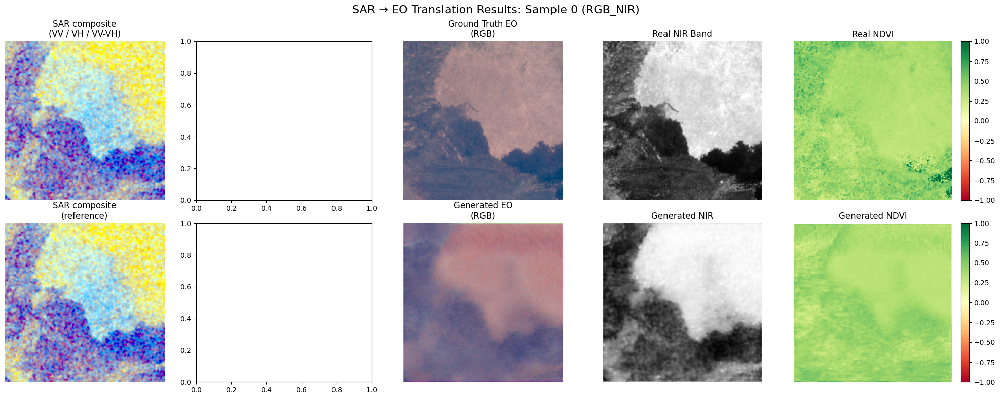

Saved detailed sample 0
Sen12MSDataset - RGB_NIR: 443 pairs, split: train
Sen12MSDataset - RGB_NIR: 95 pairs, split: val
Sen12MSDataset - RGB_NIR: 96 pairs, split: test


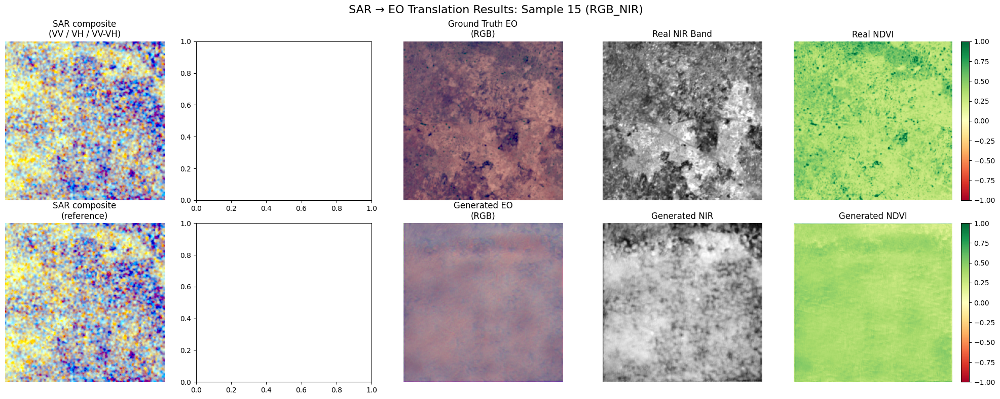

Saved detailed sample 15
Sen12MSDataset - RGB_NIR: 443 pairs, split: train
Sen12MSDataset - RGB_NIR: 95 pairs, split: val
Sen12MSDataset - RGB_NIR: 96 pairs, split: test


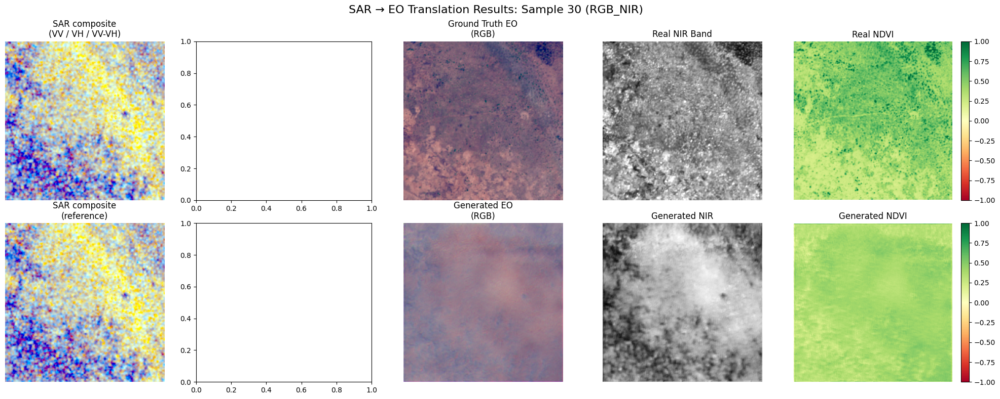

Saved detailed sample 30

2. Generating comparison grid...
Sen12MSDataset - RGB_NIR: 443 pairs, split: train
Sen12MSDataset - RGB_NIR: 95 pairs, split: val
Sen12MSDataset - RGB_NIR: 96 pairs, split: test
Sen12MSDataset - RGB_NIR: 443 pairs, split: train
Sen12MSDataset - RGB_NIR: 95 pairs, split: val
Sen12MSDataset - RGB_NIR: 96 pairs, split: test
Sen12MSDataset - RGB_NIR: 443 pairs, split: train
Sen12MSDataset - RGB_NIR: 95 pairs, split: val
Sen12MSDataset - RGB_NIR: 96 pairs, split: test
Saved comparison grid to /kaggle/working/sar_eo_samples/comparison_grid_RGB_NIR.png


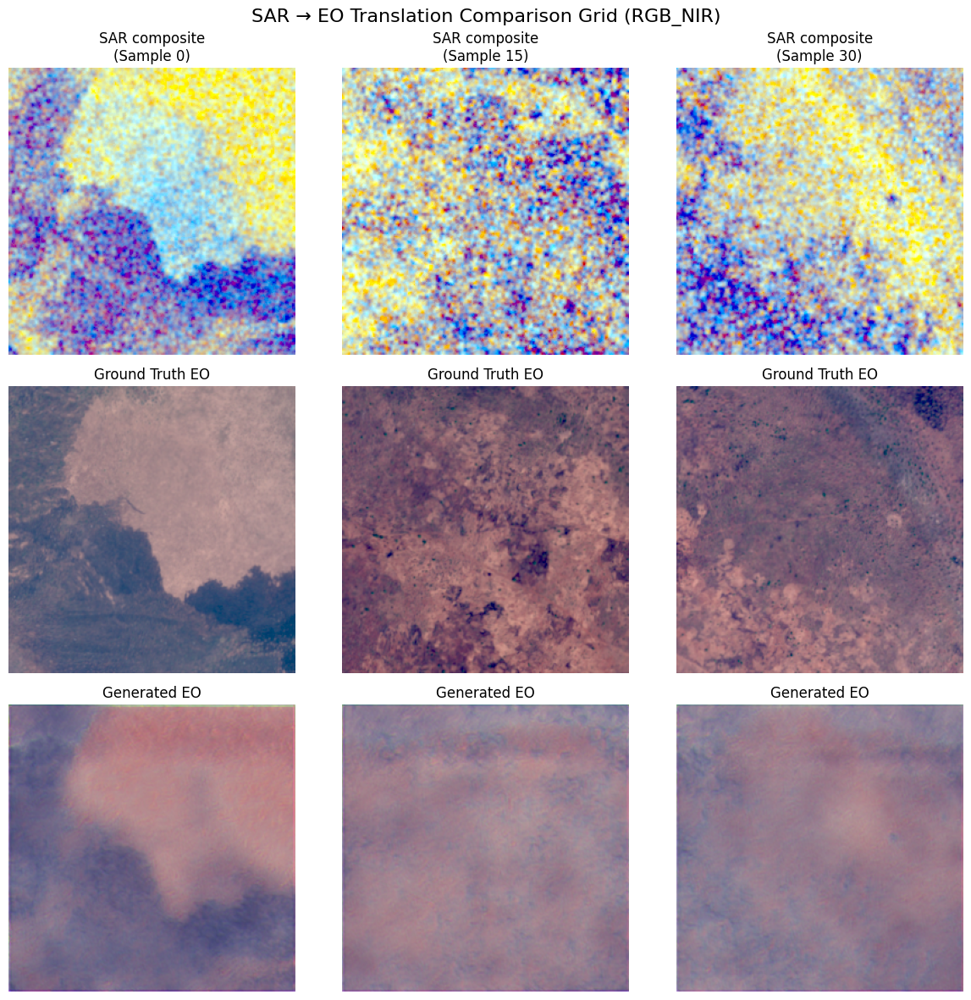


3. Generating before/after pairs...
Sen12MSDataset - RGB_NIR: 443 pairs, split: train
Sen12MSDataset - RGB_NIR: 95 pairs, split: val
Sen12MSDataset - RGB_NIR: 96 pairs, split: test


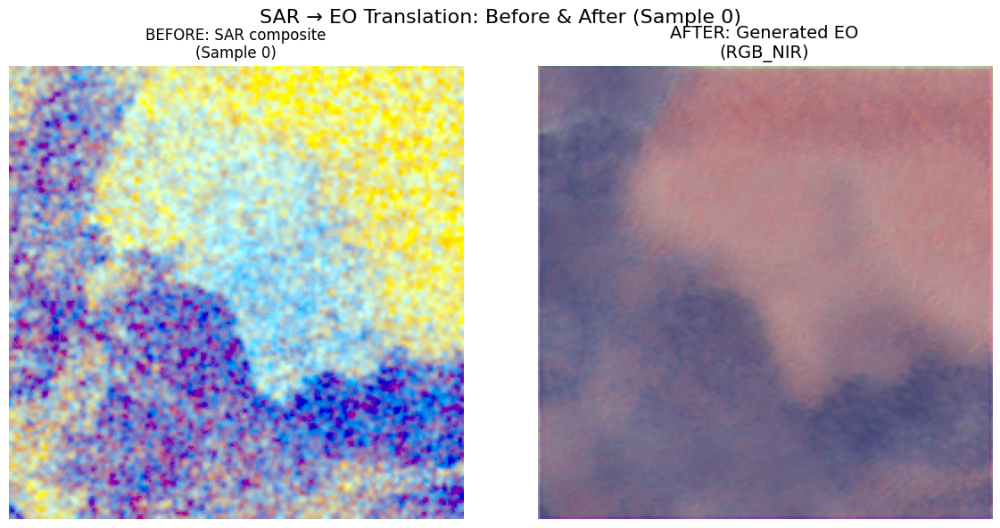

Generated before/after pair for sample 0
Sen12MSDataset - RGB_NIR: 443 pairs, split: train
Sen12MSDataset - RGB_NIR: 95 pairs, split: val
Sen12MSDataset - RGB_NIR: 96 pairs, split: test


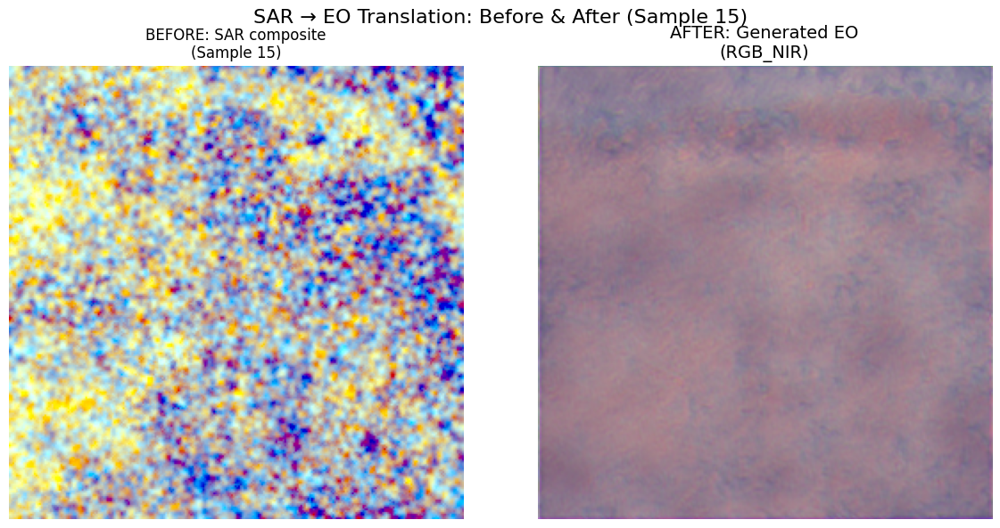

Generated before/after pair for sample 15
Sen12MSDataset - RGB_NIR: 443 pairs, split: train
Sen12MSDataset - RGB_NIR: 95 pairs, split: val
Sen12MSDataset - RGB_NIR: 96 pairs, split: test


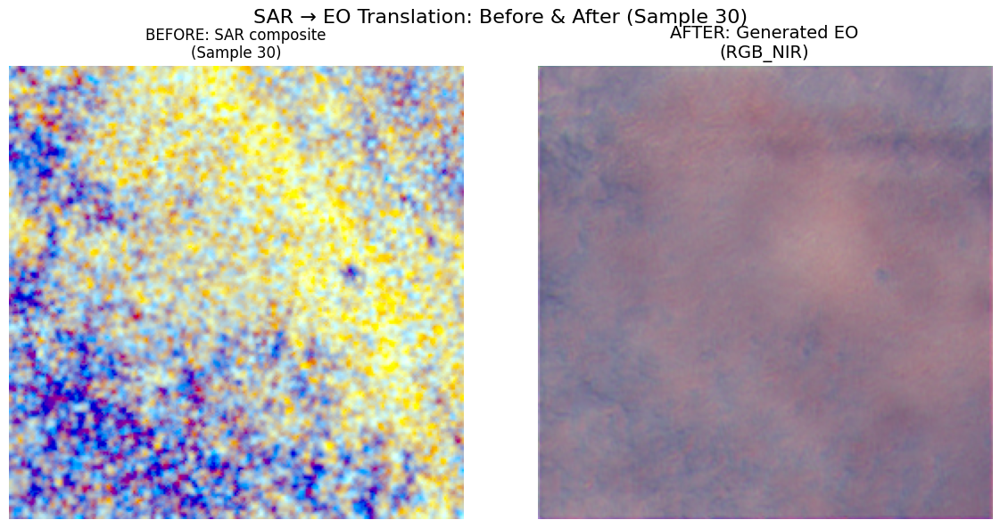

Generated before/after pair for sample 30

✅ All sample results saved to: /kaggle/working/sar_eo_samples
✅ Generated 3 sample results for RGB_NIR configuration

Generated files for RGB_NIR:
  - before_after_000_RGB_NIR.png
  - before_after_015_RGB_NIR.png
  - before_after_030_RGB_NIR.png
  - comparison_grid_RGB_NIR.png
  - detailed_sample_000_RGB_NIR.png
  - detailed_sample_015_RGB_NIR.png
  - detailed_sample_030_RGB_NIR.png


In [63]:
# Generate 5 sample results
sample_indices = create_sample_results(
    generator=G,
    device=device, 
    pipeline=pipeline,  # Your existing pipeline object
    cfg=cfg,
    n_samples=3
)

# Verify results were created
verify_results(cfg)


In [64]:
# Choose configuration and load checkpoint
cfg = "RGB"  # or "RGB" or "NIR_SWIR_RE"
checkpoint_path = "/kaggle/working/checkpoints/RGB_ep020.pth"

# Load generator
G, _, _, _ = build_cyclegan_components(cfg)
G = torch.nn.DataParallel(G)  
G.load_state_dict(torch.load(checkpoint_path)["G"])
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
G = G.to(device).eval()

print(f"Loaded {cfg} generator from {checkpoint_path}")


Loaded RGB generator from /kaggle/working/checkpoints/RGB_ep020.pth


Creating 3 SAR → EO sample results for RGB configuration...
Sen12MSDataset - RGB: 443 pairs, split: train
Sen12MSDataset - RGB: 95 pairs, split: val
Sen12MSDataset - RGB: 96 pairs, split: test
Selected sample indices: [0, 15, 30]
Total validation samples available: 95

1. Generating individual detailed samples...
Sen12MSDataset - RGB: 443 pairs, split: train
Sen12MSDataset - RGB: 95 pairs, split: val
Sen12MSDataset - RGB: 96 pairs, split: test


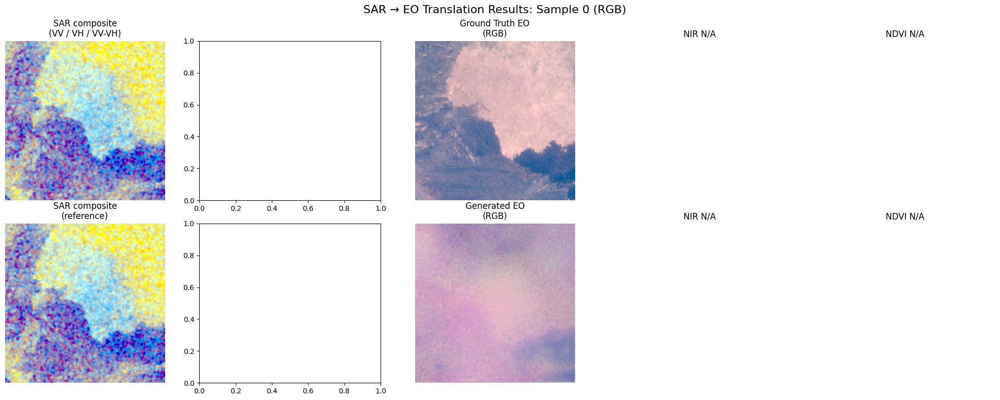

Saved detailed sample 0
Sen12MSDataset - RGB: 443 pairs, split: train
Sen12MSDataset - RGB: 95 pairs, split: val
Sen12MSDataset - RGB: 96 pairs, split: test


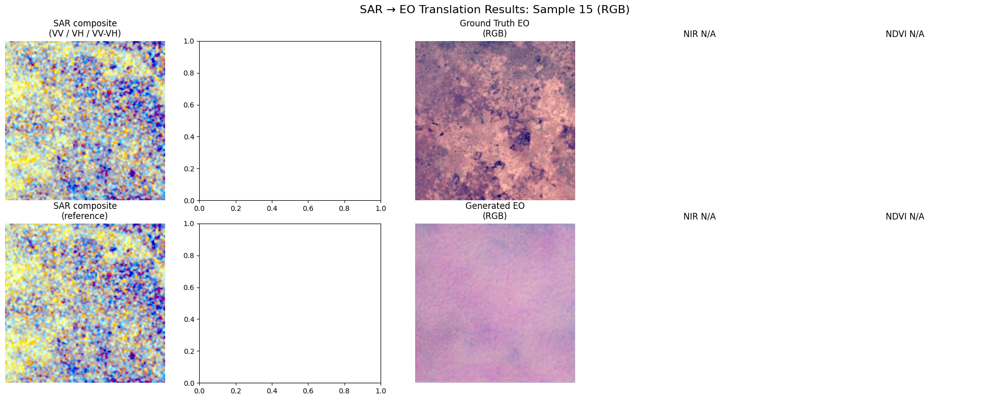

Saved detailed sample 15
Sen12MSDataset - RGB: 443 pairs, split: train
Sen12MSDataset - RGB: 95 pairs, split: val
Sen12MSDataset - RGB: 96 pairs, split: test


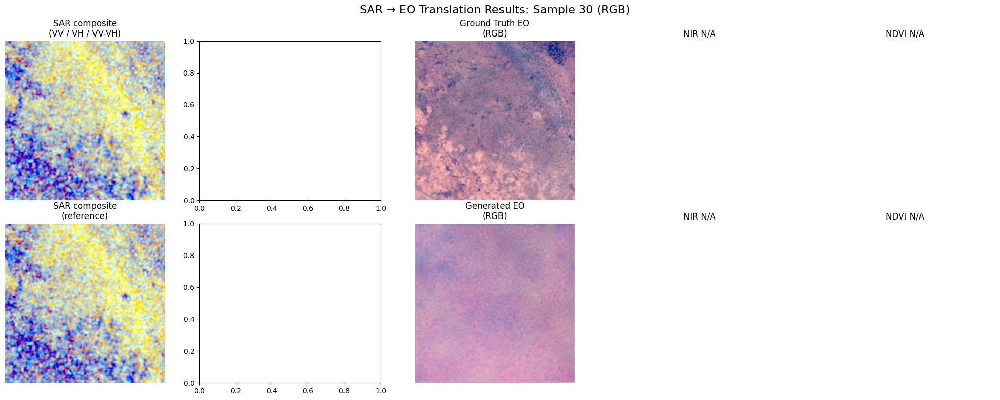

Saved detailed sample 30

2. Generating comparison grid...
Sen12MSDataset - RGB: 443 pairs, split: train
Sen12MSDataset - RGB: 95 pairs, split: val
Sen12MSDataset - RGB: 96 pairs, split: test
Sen12MSDataset - RGB: 443 pairs, split: train
Sen12MSDataset - RGB: 95 pairs, split: val
Sen12MSDataset - RGB: 96 pairs, split: test
Sen12MSDataset - RGB: 443 pairs, split: train
Sen12MSDataset - RGB: 95 pairs, split: val
Sen12MSDataset - RGB: 96 pairs, split: test
Saved comparison grid to /kaggle/working/sar_eo_samples/comparison_grid_RGB.png


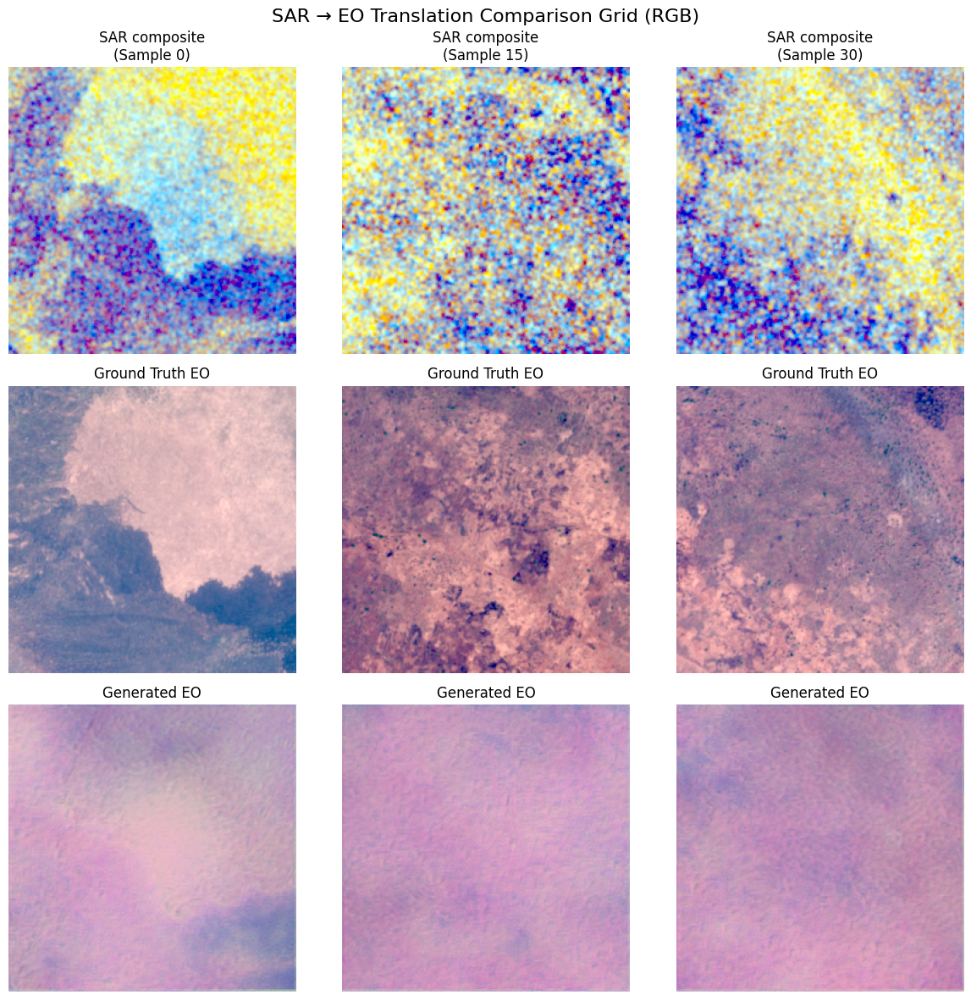


3. Generating before/after pairs...
Sen12MSDataset - RGB: 443 pairs, split: train
Sen12MSDataset - RGB: 95 pairs, split: val
Sen12MSDataset - RGB: 96 pairs, split: test


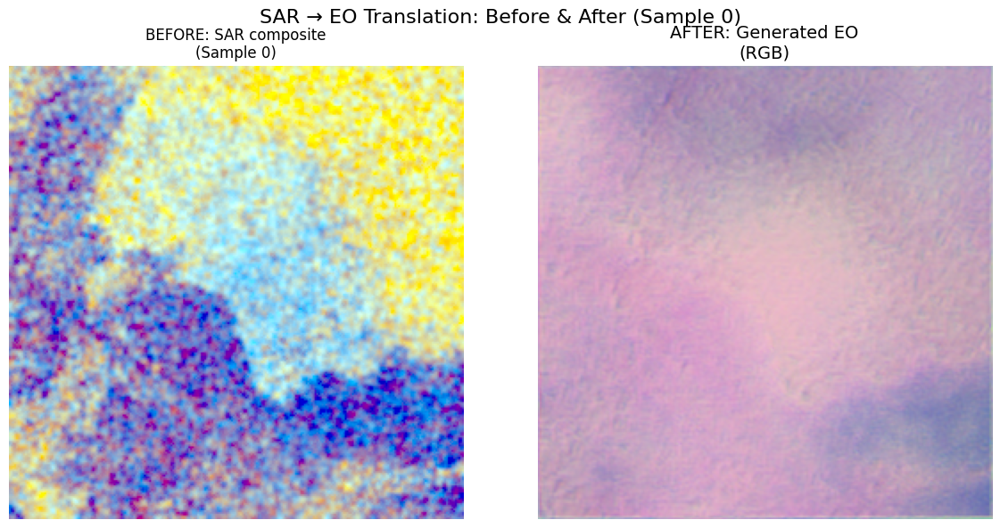

Generated before/after pair for sample 0
Sen12MSDataset - RGB: 443 pairs, split: train
Sen12MSDataset - RGB: 95 pairs, split: val
Sen12MSDataset - RGB: 96 pairs, split: test


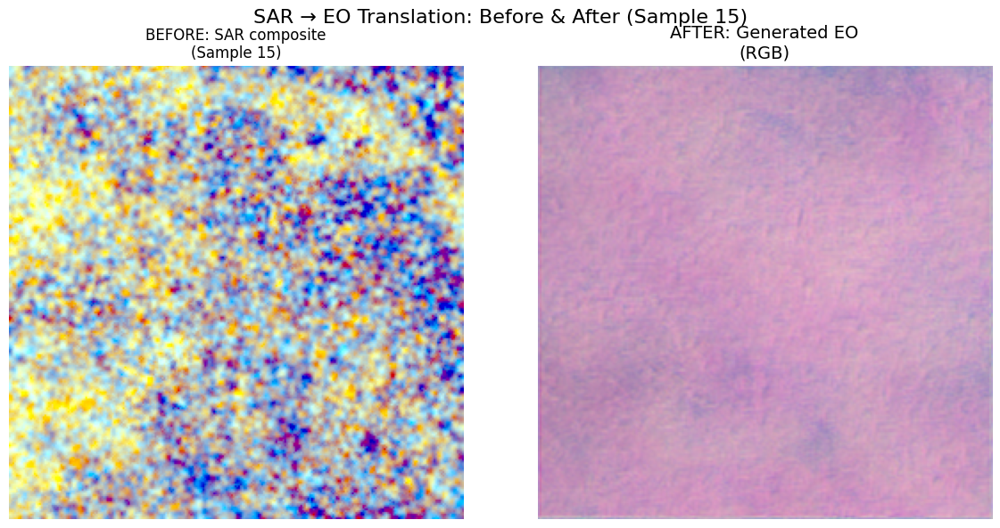

Generated before/after pair for sample 15
Sen12MSDataset - RGB: 443 pairs, split: train
Sen12MSDataset - RGB: 95 pairs, split: val
Sen12MSDataset - RGB: 96 pairs, split: test


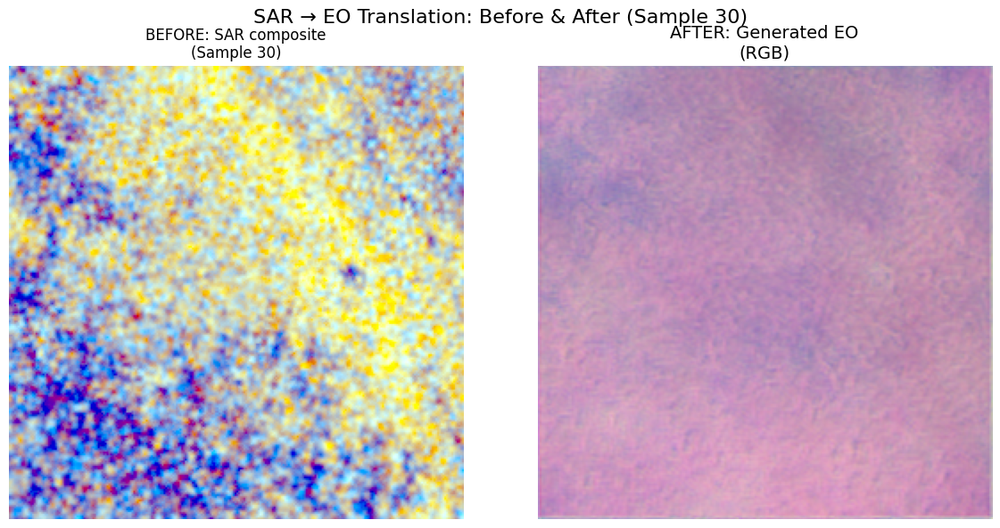

Generated before/after pair for sample 30

✅ All sample results saved to: /kaggle/working/sar_eo_samples
✅ Generated 3 sample results for RGB configuration

Generated files for RGB:
  - before_after_000_RGB.png
  - before_after_000_RGB_NIR.png
  - before_after_015_RGB.png
  - before_after_015_RGB_NIR.png
  - before_after_030_RGB.png
  - before_after_030_RGB_NIR.png
  - comparison_grid_RGB.png
  - comparison_grid_RGB_NIR.png
  - detailed_sample_000_RGB.png
  - detailed_sample_000_RGB_NIR.png
  - detailed_sample_015_RGB.png
  - detailed_sample_015_RGB_NIR.png
  - detailed_sample_030_RGB.png
  - detailed_sample_030_RGB_NIR.png


In [65]:
# Generate 5 sample results
sample_indices = create_sample_results(
    generator=G,
    device=device, 
    pipeline=pipeline,  # Your existing pipeline object
    cfg=cfg,
    n_samples=3
)

# Verify results were created
verify_results(cfg)


In [ ]:
# !ls /kaggle/working/checkpoints

In [66]:
# Choose configuration and load checkpoint
cfg = "NIR_SWIR_RE"  # or "RGB" or "NIR_SWIR_RE"
checkpoint_path = "/kaggle/working/checkpoints/NIR_SWIR_RE_ep020.pth"

# Load generator
G, _, _, _ = build_cyclegan_components(cfg)
G = torch.nn.DataParallel(G)  
G.load_state_dict(torch.load(checkpoint_path)["G"])
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
G = G.to(device).eval()

print(f"Loaded {cfg} generator from {checkpoint_path}")


Loaded NIR_SWIR_RE generator from /kaggle/working/checkpoints/NIR_SWIR_RE_ep020.pth


Creating 5 SAR → EO sample results for NIR_SWIR_RE configuration...
Sen12MSDataset - NIR_SWIR_RE: 443 pairs, split: train
Sen12MSDataset - NIR_SWIR_RE: 95 pairs, split: val
Sen12MSDataset - NIR_SWIR_RE: 96 pairs, split: test
Selected sample indices: [0, 9, 18, 27, 36]
Total validation samples available: 95

1. Generating individual detailed samples...
Sen12MSDataset - NIR_SWIR_RE: 443 pairs, split: train
Sen12MSDataset - NIR_SWIR_RE: 95 pairs, split: val
Sen12MSDataset - NIR_SWIR_RE: 96 pairs, split: test


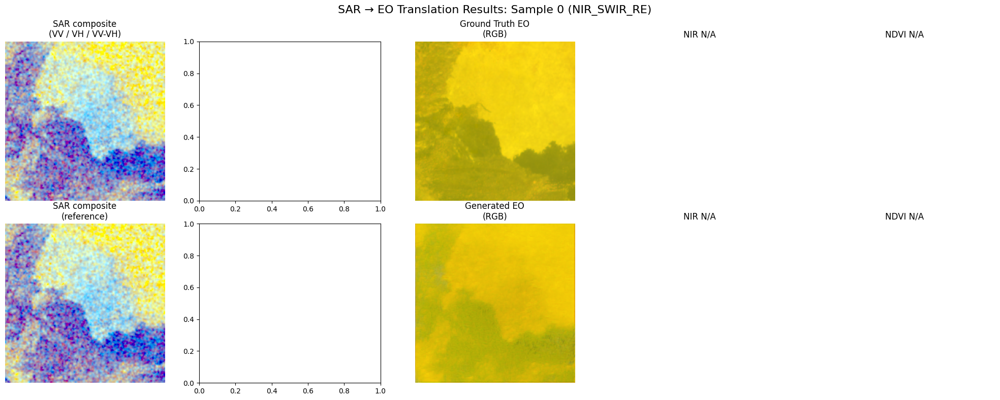

Saved detailed sample 0
Sen12MSDataset - NIR_SWIR_RE: 443 pairs, split: train
Sen12MSDataset - NIR_SWIR_RE: 95 pairs, split: val
Sen12MSDataset - NIR_SWIR_RE: 96 pairs, split: test


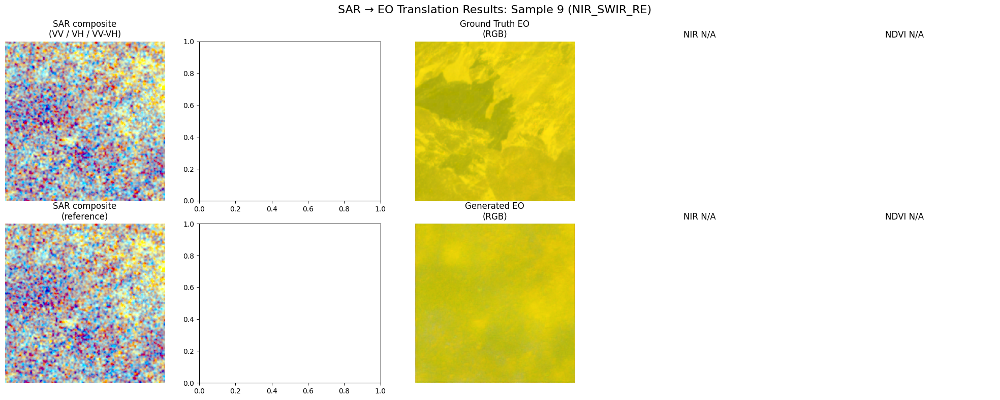

Saved detailed sample 9
Sen12MSDataset - NIR_SWIR_RE: 443 pairs, split: train
Sen12MSDataset - NIR_SWIR_RE: 95 pairs, split: val
Sen12MSDataset - NIR_SWIR_RE: 96 pairs, split: test


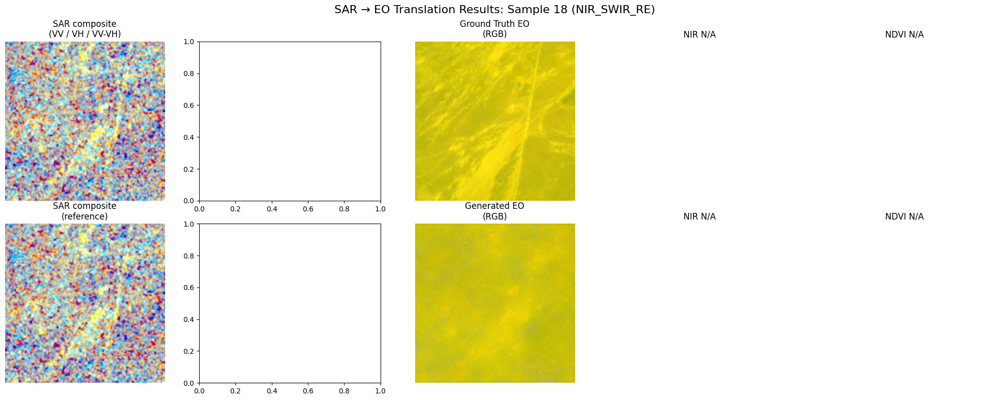

Saved detailed sample 18
Sen12MSDataset - NIR_SWIR_RE: 443 pairs, split: train
Sen12MSDataset - NIR_SWIR_RE: 95 pairs, split: val
Sen12MSDataset - NIR_SWIR_RE: 96 pairs, split: test


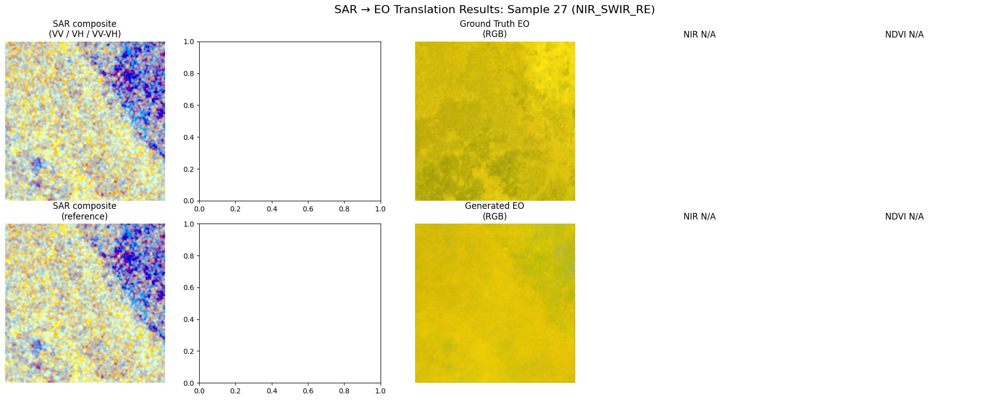

Saved detailed sample 27
Sen12MSDataset - NIR_SWIR_RE: 443 pairs, split: train
Sen12MSDataset - NIR_SWIR_RE: 95 pairs, split: val
Sen12MSDataset - NIR_SWIR_RE: 96 pairs, split: test


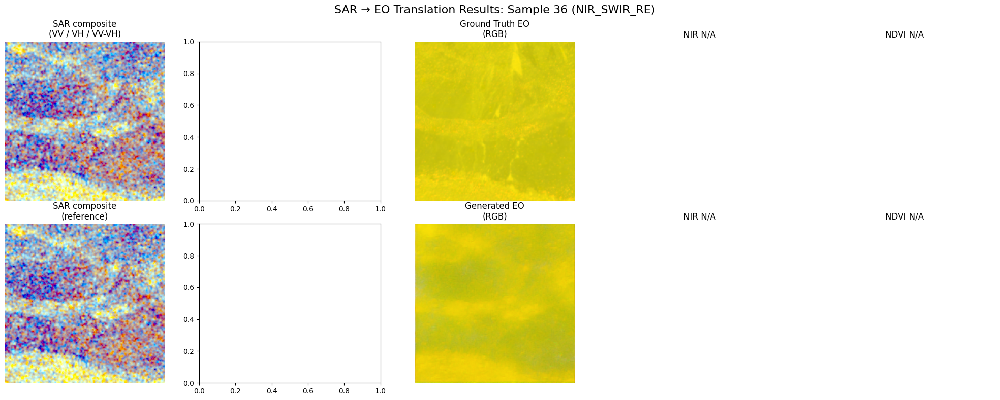

Saved detailed sample 36

2. Generating comparison grid...
Sen12MSDataset - NIR_SWIR_RE: 443 pairs, split: train
Sen12MSDataset - NIR_SWIR_RE: 95 pairs, split: val
Sen12MSDataset - NIR_SWIR_RE: 96 pairs, split: test
Sen12MSDataset - NIR_SWIR_RE: 443 pairs, split: train
Sen12MSDataset - NIR_SWIR_RE: 95 pairs, split: val
Sen12MSDataset - NIR_SWIR_RE: 96 pairs, split: test
Sen12MSDataset - NIR_SWIR_RE: 443 pairs, split: train
Sen12MSDataset - NIR_SWIR_RE: 95 pairs, split: val
Sen12MSDataset - NIR_SWIR_RE: 96 pairs, split: test
Sen12MSDataset - NIR_SWIR_RE: 443 pairs, split: train
Sen12MSDataset - NIR_SWIR_RE: 95 pairs, split: val
Sen12MSDataset - NIR_SWIR_RE: 96 pairs, split: test
Sen12MSDataset - NIR_SWIR_RE: 443 pairs, split: train
Sen12MSDataset - NIR_SWIR_RE: 95 pairs, split: val
Sen12MSDataset - NIR_SWIR_RE: 96 pairs, split: test
Saved comparison grid to /kaggle/working/sar_eo_samples/comparison_grid_NIR_SWIR_RE.png


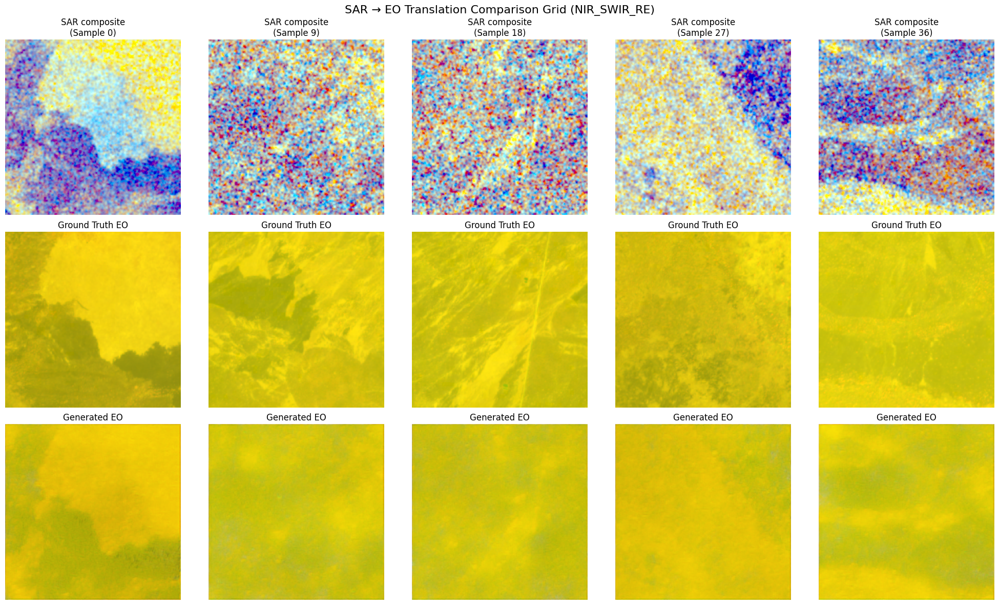


3. Generating before/after pairs...
Sen12MSDataset - NIR_SWIR_RE: 443 pairs, split: train
Sen12MSDataset - NIR_SWIR_RE: 95 pairs, split: val
Sen12MSDataset - NIR_SWIR_RE: 96 pairs, split: test


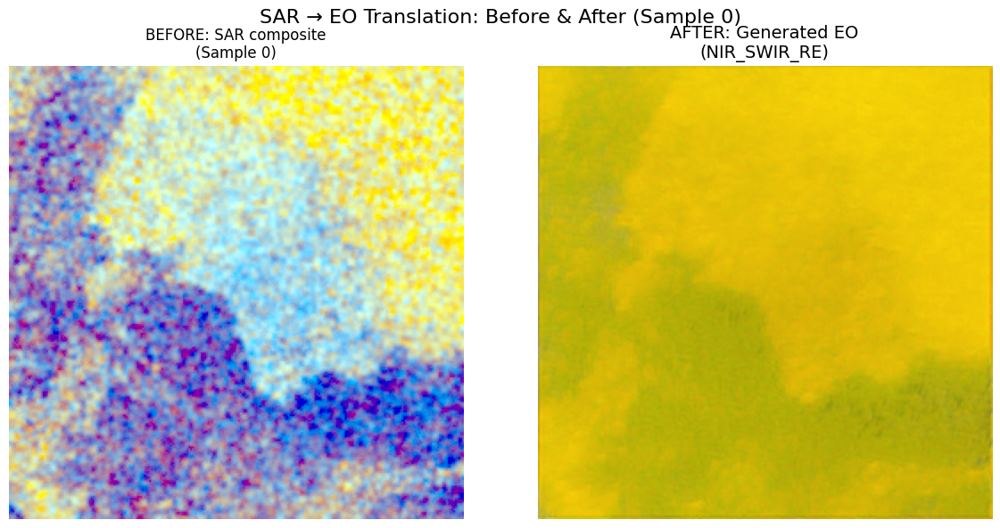

Generated before/after pair for sample 0
Sen12MSDataset - NIR_SWIR_RE: 443 pairs, split: train
Sen12MSDataset - NIR_SWIR_RE: 95 pairs, split: val
Sen12MSDataset - NIR_SWIR_RE: 96 pairs, split: test


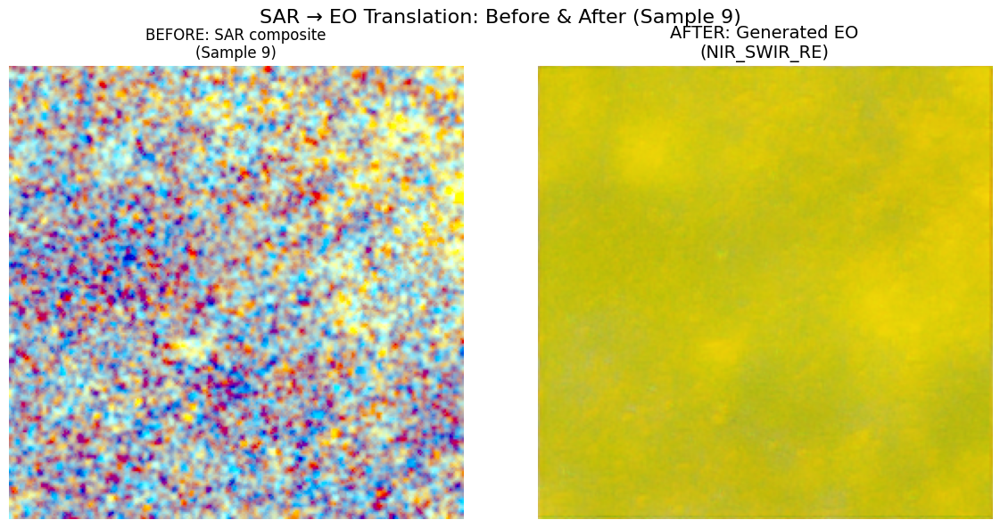

Generated before/after pair for sample 9
Sen12MSDataset - NIR_SWIR_RE: 443 pairs, split: train
Sen12MSDataset - NIR_SWIR_RE: 95 pairs, split: val
Sen12MSDataset - NIR_SWIR_RE: 96 pairs, split: test


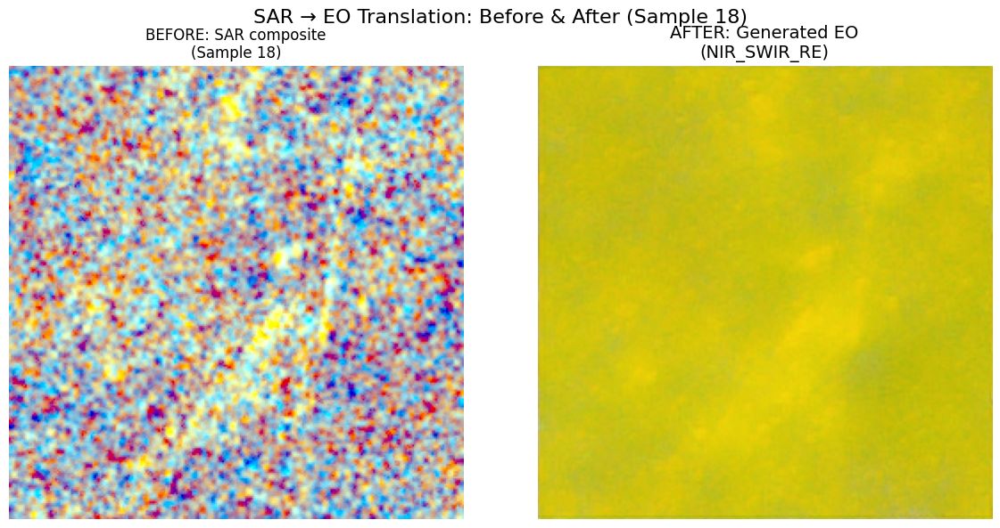

Generated before/after pair for sample 18
Sen12MSDataset - NIR_SWIR_RE: 443 pairs, split: train
Sen12MSDataset - NIR_SWIR_RE: 95 pairs, split: val
Sen12MSDataset - NIR_SWIR_RE: 96 pairs, split: test


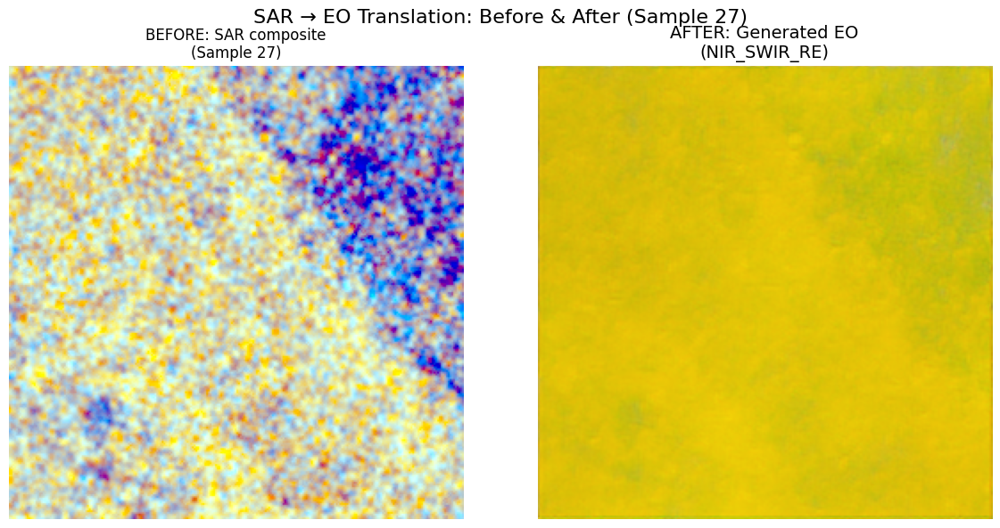

Generated before/after pair for sample 27
Sen12MSDataset - NIR_SWIR_RE: 443 pairs, split: train
Sen12MSDataset - NIR_SWIR_RE: 95 pairs, split: val
Sen12MSDataset - NIR_SWIR_RE: 96 pairs, split: test


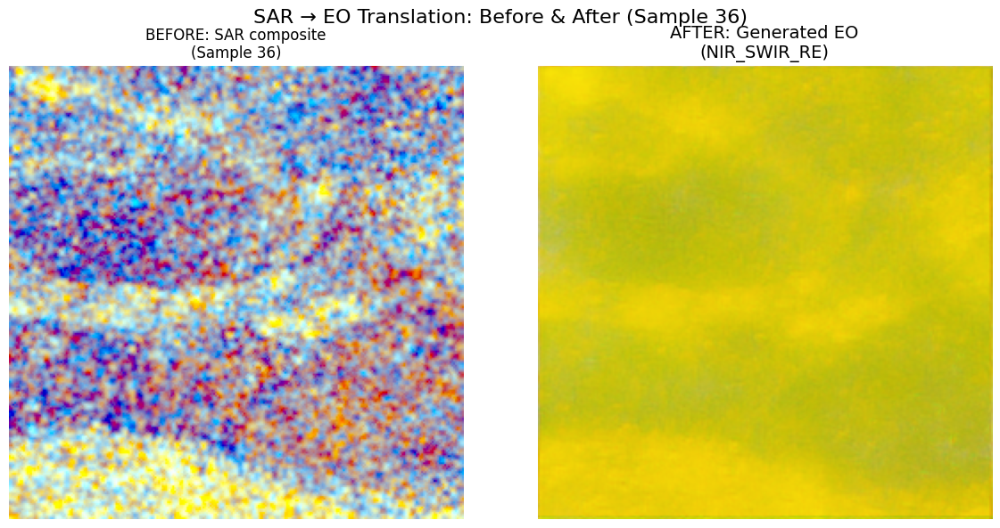

Generated before/after pair for sample 36

✅ All sample results saved to: /kaggle/working/sar_eo_samples
✅ Generated 5 sample results for NIR_SWIR_RE configuration

Generated files for NIR_SWIR_RE:
  - before_after_000_NIR_SWIR_RE.png
  - before_after_009_NIR_SWIR_RE.png
  - before_after_018_NIR_SWIR_RE.png
  - before_after_027_NIR_SWIR_RE.png
  - before_after_036_NIR_SWIR_RE.png
  - comparison_grid_NIR_SWIR_RE.png
  - detailed_sample_000_NIR_SWIR_RE.png
  - detailed_sample_009_NIR_SWIR_RE.png
  - detailed_sample_018_NIR_SWIR_RE.png
  - detailed_sample_027_NIR_SWIR_RE.png
  - detailed_sample_036_NIR_SWIR_RE.png


In [67]:
# Generate 5 sample results
sample_indices = create_sample_results(
    generator=G,
    device=device, 
    pipeline=pipeline,  # Your existing pipeline object
    cfg=cfg,
    n_samples=5
)

# Verify results were created
verify_results(cfg)


In [71]:
!zip -r /kaggle/working/samples.zip /kaggle/working/sar_eo_samples


updating: kaggle/working/sar_eo_samples/ (stored 0%)
updating: kaggle/working/sar_eo_samples/before_after_030_RGB_NIR.png (deflated 0%)
updating: kaggle/working/sar_eo_samples/detailed_sample_000_RGB_NIR.png (deflated 1%)
updating: kaggle/working/sar_eo_samples/comparison_grid_RGB_NIR.png (deflated 0%)
updating: kaggle/working/sar_eo_samples/before_after_000_RGB_NIR.png (deflated 0%)
updating: kaggle/working/sar_eo_samples/before_after_015_RGB_NIR.png (deflated 0%)
updating: kaggle/working/sar_eo_samples/detailed_sample_015_RGB_NIR.png (deflated 1%)
updating: kaggle/working/sar_eo_samples/detailed_sample_030_RGB_NIR.png (deflated 1%)
updating: kaggle/working/sar_eo_samples/detailed_sample_015_RGB.png (deflated 2%)
updating: kaggle/working/sar_eo_samples/before_after_018_NIR_SWIR_RE.png (deflated 0%)
updating: kaggle/working/sar_eo_samples/before_after_036_NIR_SWIR_RE.png (deflated 0%)
updating: kaggle/working/sar_eo_samples/comparison_grid_NIR_SWIR_RE.png (deflated 0%)
updating: kaggle

In [ ]:
!zip -r /kaggle/working/checkpoints.zip /kaggle/working/checkpoints


In [68]:
from IPython.display import FileLink
FileLink('checkpoints/NIR_SWIR_RE_ep020.pth')          # file must already be in /kaggle/working


/kaggle/working/checkpoints/NIR_SWIR_RE_ep020.pth

In [69]:
FileLink('checkpoints/RGB_ep020.pth')          # file must already be in /kaggle/working


/kaggle/working/checkpoints/RGB_ep020.pth

In [70]:
FileLink('checkpoints/RGB_NIR_ep020.pth')          # file must already be in /kaggle/working


/kaggle/working/checkpoints/RGB_NIR_ep020.pth

In [73]:
FileLink('/kaggle/working/samples.zip')          # file must already be in /kaggle/working


/kaggle/working/samples.zip

In [28]:
# %%bash
# for f in /kaggle/working/checkpoints/*_ep*.pth; do
#     num=${f##*_ep}        # get the 3-digit epoch, e.g. 040
#     num=${num%.pth}
#     if [ "$num" -gt 15 ]; then
#         rm -v "$f"        # delete files whose epoch >15
#     fi
# done


removed '/kaggle/working/checkpoints/NIR_SWIR_RE_ep020.pth'
removed '/kaggle/working/checkpoints/NIR_SWIR_RE_ep030.pth'
removed '/kaggle/working/checkpoints/NIR_SWIR_RE_ep040.pth'
removed '/kaggle/working/checkpoints/NIR_SWIR_RE_ep050.pth'
removed '/kaggle/working/checkpoints/RGB_ep020.pth'
removed '/kaggle/working/checkpoints/RGB_ep030.pth'
removed '/kaggle/working/checkpoints/RGB_ep040.pth'
removed '/kaggle/working/checkpoints/RGB_ep050.pth'
removed '/kaggle/working/checkpoints/RGB_NIR_ep020.pth'
removed '/kaggle/working/checkpoints/RGB_NIR_ep030.pth'
removed '/kaggle/working/checkpoints/RGB_NIR_ep040.pth'
removed '/kaggle/working/checkpoints/RGB_NIR_ep050.pth'
